In [375]:
import numpy as np
import pandas as pd

In [376]:
# range for capacitance plots: 0-0.65
# range for cell size: 0-30000 square micrometer
# range for firing rate: 0-250 Hz

In [377]:
ME_df=pd.read_csv('../result/ME_sweep-wise.tsv',sep='\t')

In [378]:
for specimen_id in set(ME_df.specimen_id):
    max_id=ME_df[ME_df['specimen_id']==specimen_id]['sweep_FR'].idxmax(axis=0)
    ME_df.loc[max_id,'max_FR_sweep']=True

In [379]:
for specimen_id in set(ME_df.specimen_id):
    min_id=ME_df[ME_df['specimen_id']==specimen_id]['sweep_FR'].idxmin(axis=0)
    ME_df.loc[min_id,'min_FR_sweep']=True

In [405]:
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    rheobase=df['ef__threshold_i_long_square'].iloc[0]
    threshold_min = rheobase+40
    threshold_max = rheobase+60
    for index in df.index:
        if threshold_min <= df.loc[index,'stimulus_absolute_amplitude'] <= threshold_max:
            ME_df.loc[index,'representative_sweep']=True
            break

In [410]:
len(ME_df[ME_df['representative_sweep']==True])

315

In [409]:
len(set(ME_df['specimen_id']))

367

In [411]:
ME_df['FRxC']=ME_df['sweep_FR']*ME_df['capacitance']

In [414]:
ME_df[['specimen_id','FRxC','sweep_FR','capacitance']]

,specimen_id,FRxC,sweep_FR,capacitance
0,561435279.0,NaN,NaN,0.106953
1,561435279.0,NaN,NaN,0.106953
2,561435279.0,NaN,NaN,0.106953
3,561435279.0,NaN,NaN,0.106953
4,561435279.0,NaN,NaN,0.106953
...,...,...,...,...
9828,531517778.0,NaN,NaN,0.537905
9829,531517778.0,0.537916,1.00002,0.537905
9830,531517778.0,0.537916,1.00002,0.537905
9831,531517778.0,0.537916,1.00002,0.537905


In [416]:
ME_df['log capacitance']=np.log10(ME_df['capacitance'])

In [417]:
ME_df['log FR']=np.log10(ME_df['sweep_FR'])

In [418]:
ME_df['log Cell Size']=np.log10(ME_df['nm_volume'])

In [420]:
ME_df['log Cell Surface Area']=np.log10(ME_df['nm_surface_area'])

In [421]:
ME_df['log Input Resistance']=np.log10(ME_df['ef__ri'])

In [422]:
ME_df['log Tau']=np.log10(ME_df['ef__tau'])

In [425]:
for index_id in ME_df.index:
    if ME_df.loc[index_id,'stimulus_absolute_amplitude']>0:
        ME_df.loc[index_id,'log Stimulus Amplitude']=np.log10(ME_df.loc[index_id,'stimulus_absolute_amplitude'])
    else:
        ME_df.loc[index_id,'log Stimulus Amplitude']=np.nan   

In [426]:
for index_id in ME_df.index:
    if ME_df.loc[index_id,'ef__f_i_curve_slope']>0:
        ME_df.loc[index_id,'log F-I Curve Slope']=np.log10(ME_df.loc[index_id,'ef__f_i_curve_slope'])
    else:
        ME_df.loc[index_id,'log F-I Curve Slope']=np.nan   

In [427]:
ME_df['log FRxC']=np.log10(ME_df['FRxC'])

In [429]:
ME_df.to_csv('../result/ME_sweep-wise_w_label_and_log.tsv',sep='\t',index=False)

Below are codes for graphing and analyzing. Moving to Different Jupyter Notebook. 

In [28]:
max_FR_df = ME_df[ME_df['max_FR_sweep']==True]

In [73]:
min_FR_df = ME_df[ME_df['min_FR_sweep']==True]

In [29]:
import pingouin as pg

/opt/anaconda3/lib/python3.8/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.0, the latest is 0.2.1.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(
/opt/anaconda3/lib/python3.8/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.3.8, the latest is 0.4.0.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [41]:
spiny_max_FR_df=max_FR_df[max_FR_df['tag__dendrite_type']=='spiny']
aspiny_max_FR_df=max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']
sparsely_spiny_max_FR_df=max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']

In [46]:
pg.corr(max_FR_df['capacitance'],max_FR_df['nm_volume'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,367,0.740662,"[0.69, 0.78]",0.54858,0.546099,5.140252e-65,1.0


In [48]:
pg.corr(spiny_max_FR_df['capacitance'],spiny_max_FR_df['nm_volume'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,120,0.641614,"[0.52, 0.74]",0.411669,0.401612,2.887213e-15,1.0


In [49]:
pg.corr(aspiny_max_FR_df['capacitance'],aspiny_max_FR_df['nm_volume'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,0.5441,"[0.44, 0.63]",0.296045,0.289005,4.869327e-17,1.0


In [51]:
pg.corr(sparsely_spiny_max_FR_df['capacitance'],sparsely_spiny_max_FR_df['nm_volume'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.761804,"[0.6, 0.86]",0.580345,0.559875,1.904318e-09,0.999997


In [ ]:
from matplotlib import rcParams
rcParams['figure.dpi']=600
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [185]:
palette={'spiny':'tab:green',
         'aspiny':'tab:red',
         'sparsely spiny':'tab:orange'
        }

In [38]:
rcParams['figure.dpi']=600

<AxesSubplot:xlabel='nm_volume', ylabel='capacitance'>

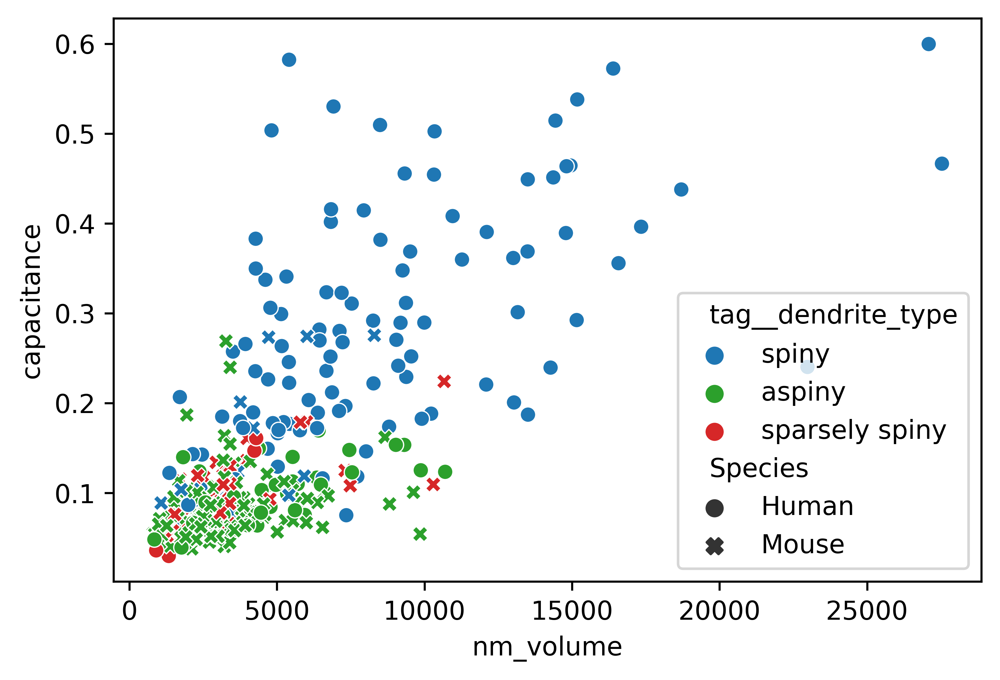

In [54]:
sns.scatterplot(data=max_FR_df, x="nm_volume", y="capacitance", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [37]:
pg.linear_regression(max_FR_df['capacitance'],max_FR_df['nm_volume'])

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1356.345194,224.166406,6.050618,3.577965e-09,0.528315,0.527022,915.525409,1797.164979
1,capacitance,24426.810758,1208.092705,20.219318,1.583331e-61,0.528315,0.527022,22051.115064,26802.506453


<AxesSubplot:xlabel='nm_volume', ylabel='ef__ri'>

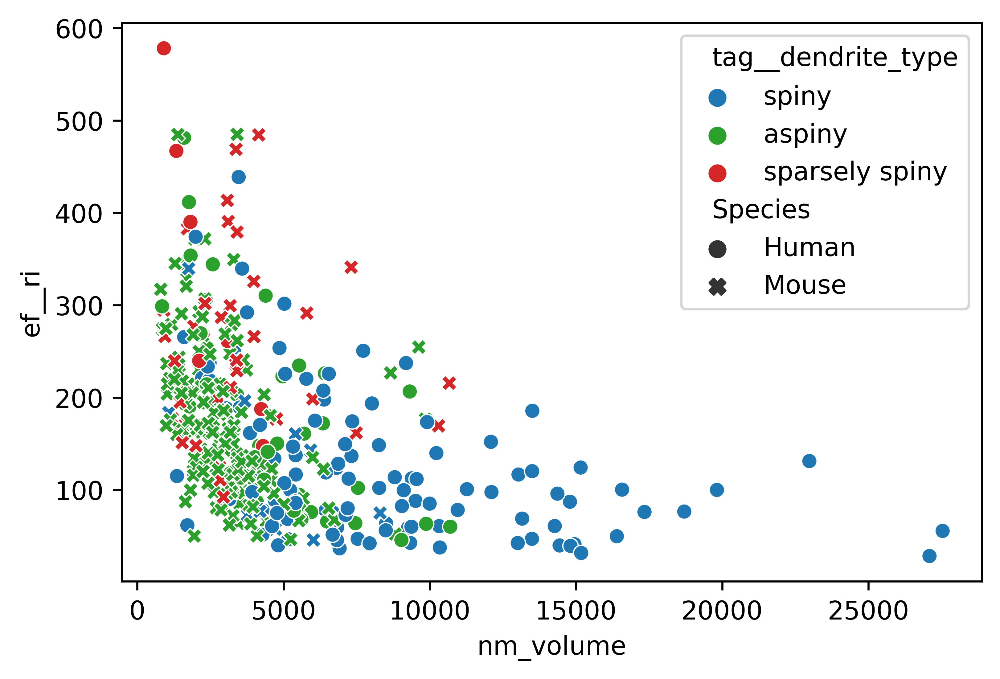

In [55]:
sns.scatterplot(data=max_FR_df, x="nm_volume", y="ef__ri", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__ri', ylabel='sweep_FR'>

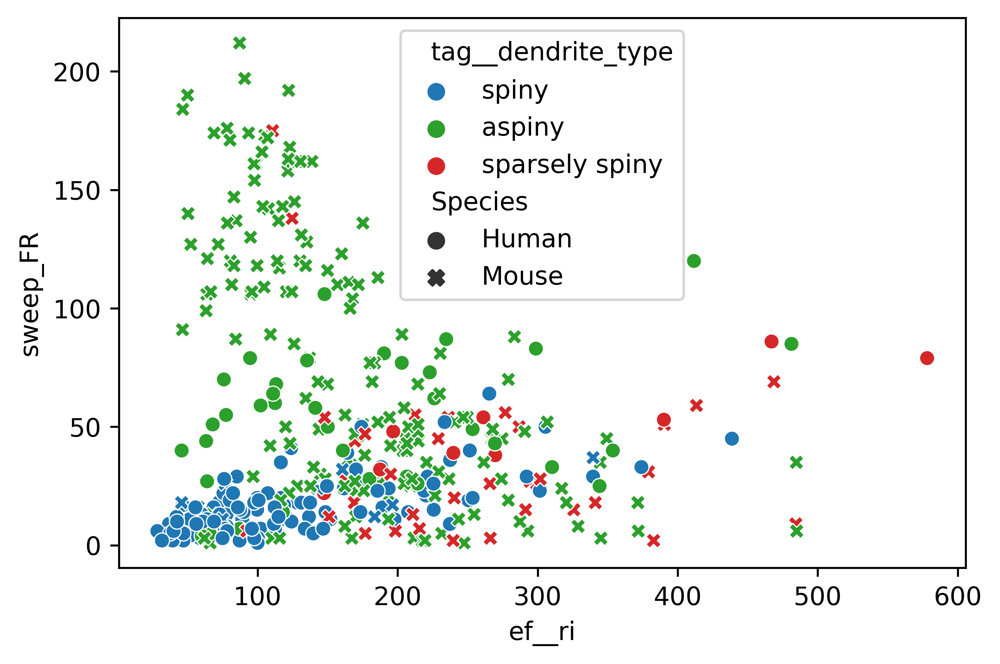

In [147]:
sns.scatterplot(data=max_FR_df, x="ef__ri", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='ef__tau'>

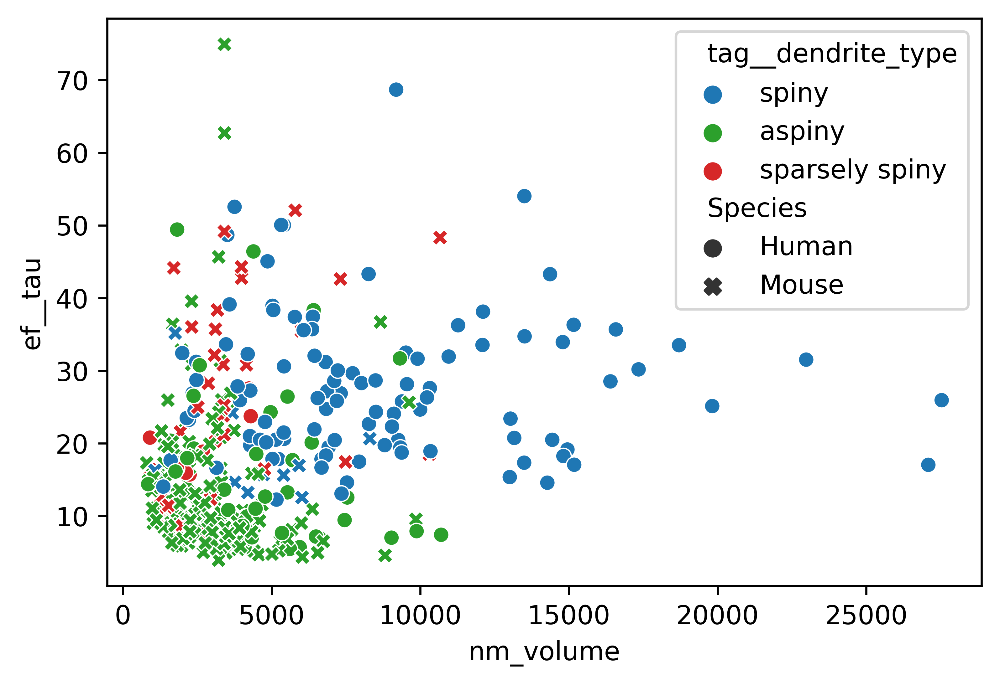

In [56]:
sns.scatterplot(data=max_FR_df, x="nm_volume", y="ef__tau", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__tau', ylabel='sweep_FR'>

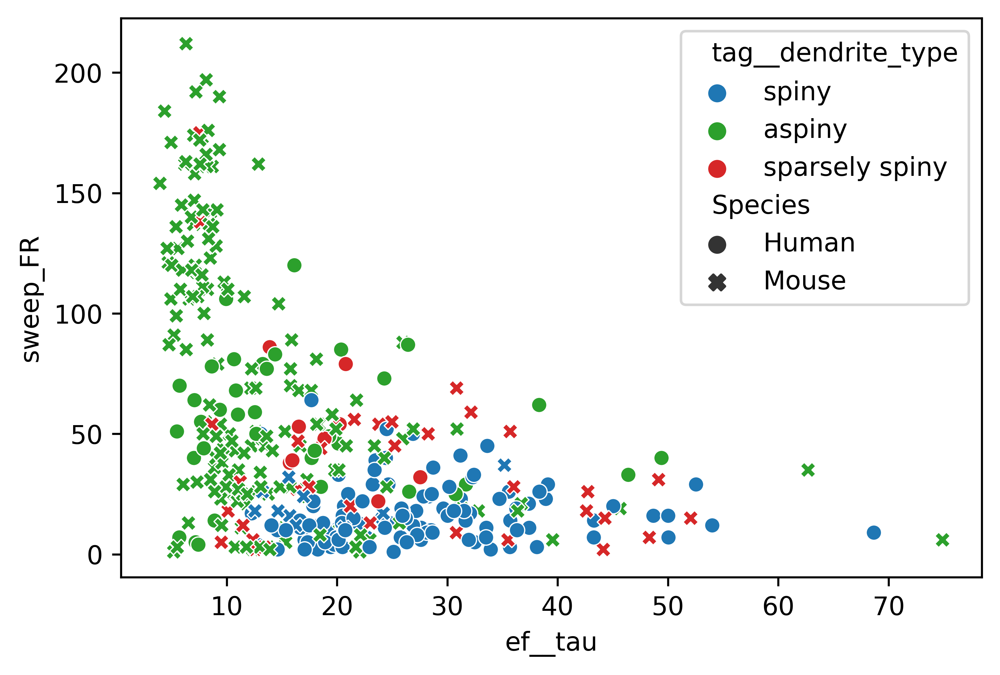

In [146]:
sns.scatterplot(data=max_FR_df, x="ef__tau", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

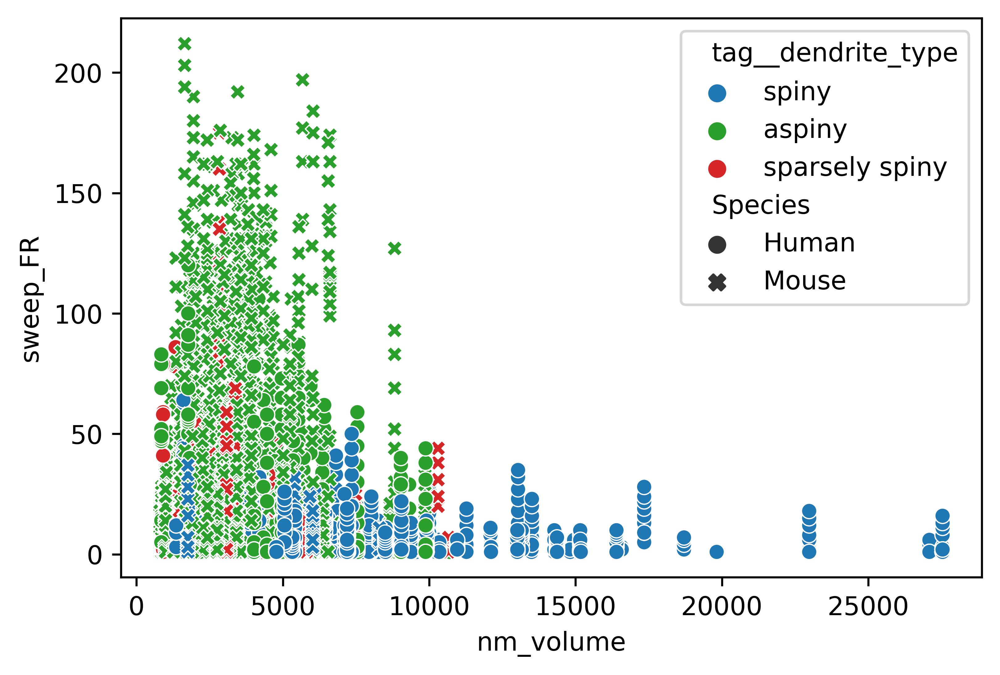

In [58]:
sns.scatterplot(data=ME_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

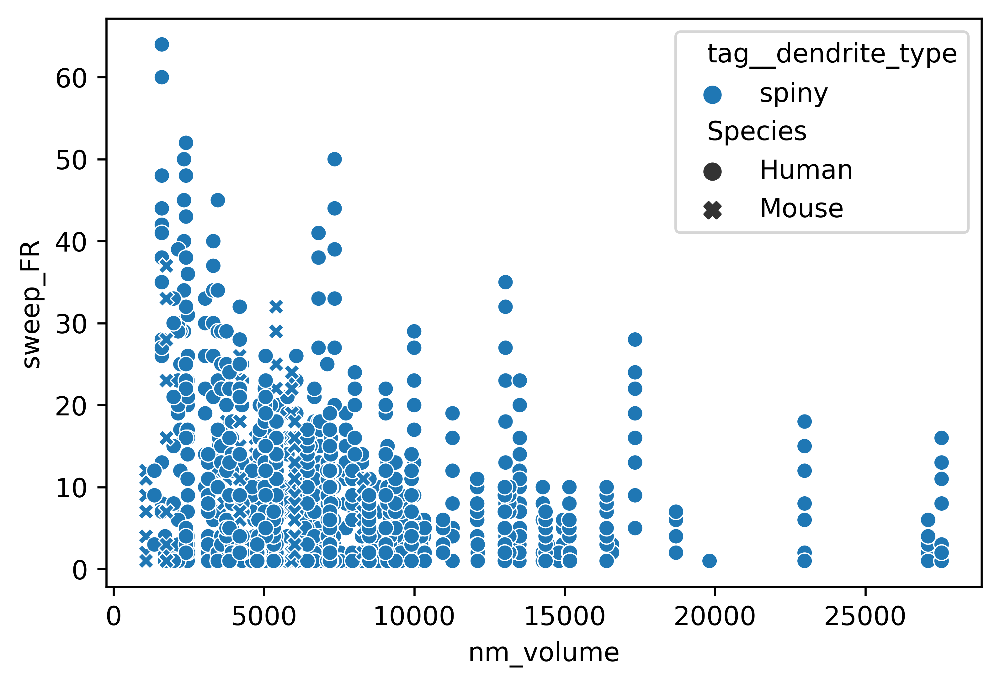

In [145]:
sns.scatterplot(data=ME_df[ME_df['tag__dendrite_type']=='spiny'], x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [68]:
pg.partial_corr(data=ME_df, x='nm_volume', y='sweep_FR', covar='stimulus_absolute_amplitude',method='pearson')

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,4805,-0.323899,"[-0.35, -0.3]",0.104911,0.104538,9.058140e-118,6.339e+113,1.0


In [67]:
pg.partial_corr(data=ME_df, x='nm_volume', y='sweep_FR', covar='stimulus_absolute_amplitude',method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,4805,-0.331254,"[-0.36, -0.31]",0.109729,0.109358,2.077660e-123,1.0


In [140]:
df=ME_df[ME_df['tag__dendrite_type']=='spiny']
pg.partial_corr(data=df, x='nm_volume', y='sweep_FR', covar='stimulus_absolute_amplitude',method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,1492,-0.306022,"[-0.35, -0.26]",0.093649,0.092432,1.029090e-33,1.0


In [141]:
df=ME_df[ME_df['tag__dendrite_type']=='aspiny']
pg.partial_corr(data=df, x='nm_volume', y='sweep_FR', covar='stimulus_absolute_amplitude',method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,2697,-0.155726,"[-0.19, -0.12]",0.024251,0.023526,4.181974e-16,1.0


In [142]:
df=ME_df[ME_df['tag__dendrite_type']=='sparsely spiny']
pg.partial_corr(data=df, x='nm_volume', y='sweep_FR', covar='stimulus_absolute_amplitude',method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,616,-0.029796,"[-0.11, 0.05]",0.000888,-0.002372,0.460412,0.114398


In [69]:
pg.partial_corr(data=ME_df, x='stimulus_absolute_amplitude', y='sweep_FR', covar='nm_volume',method='pearson')

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,4805,0.439219,"[0.42, 0.46]",0.192913,0.192577,7.707612e-226,4.959e+221,1.0


In [70]:
pg.partial_corr(data=ME_df, x='stimulus_absolute_amplitude', y='sweep_FR', covar='nm_volume',method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,4805,0.334259,"[0.31, 0.36]",0.111729,0.111359,9.295899e-126,1.0


<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

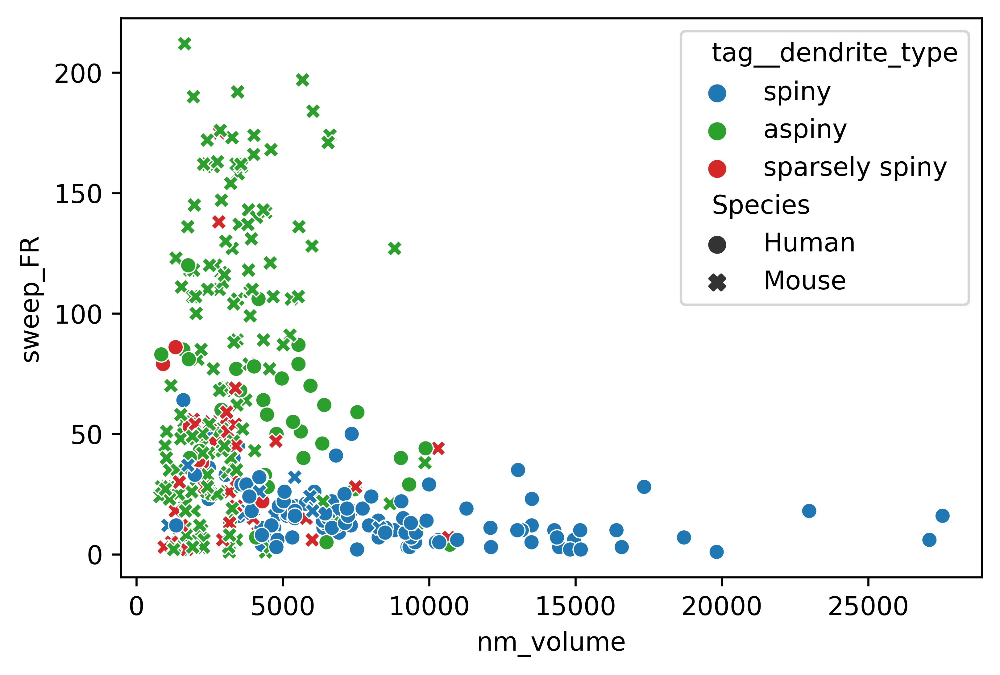

In [71]:
sns.scatterplot(data=max_FR_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

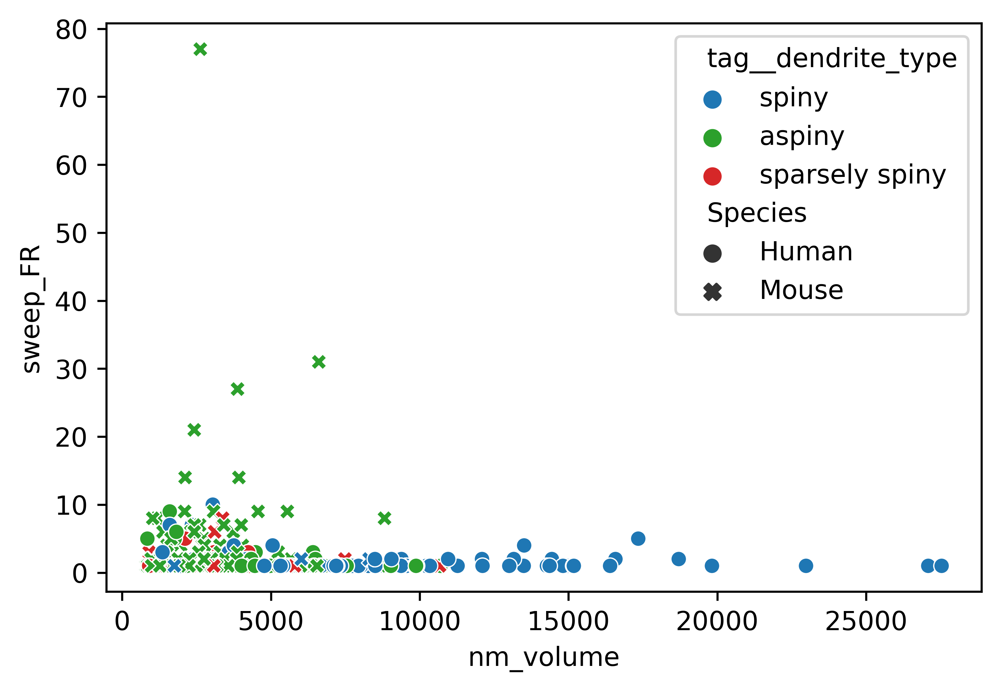

In [74]:
sns.scatterplot(data=min_FR_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

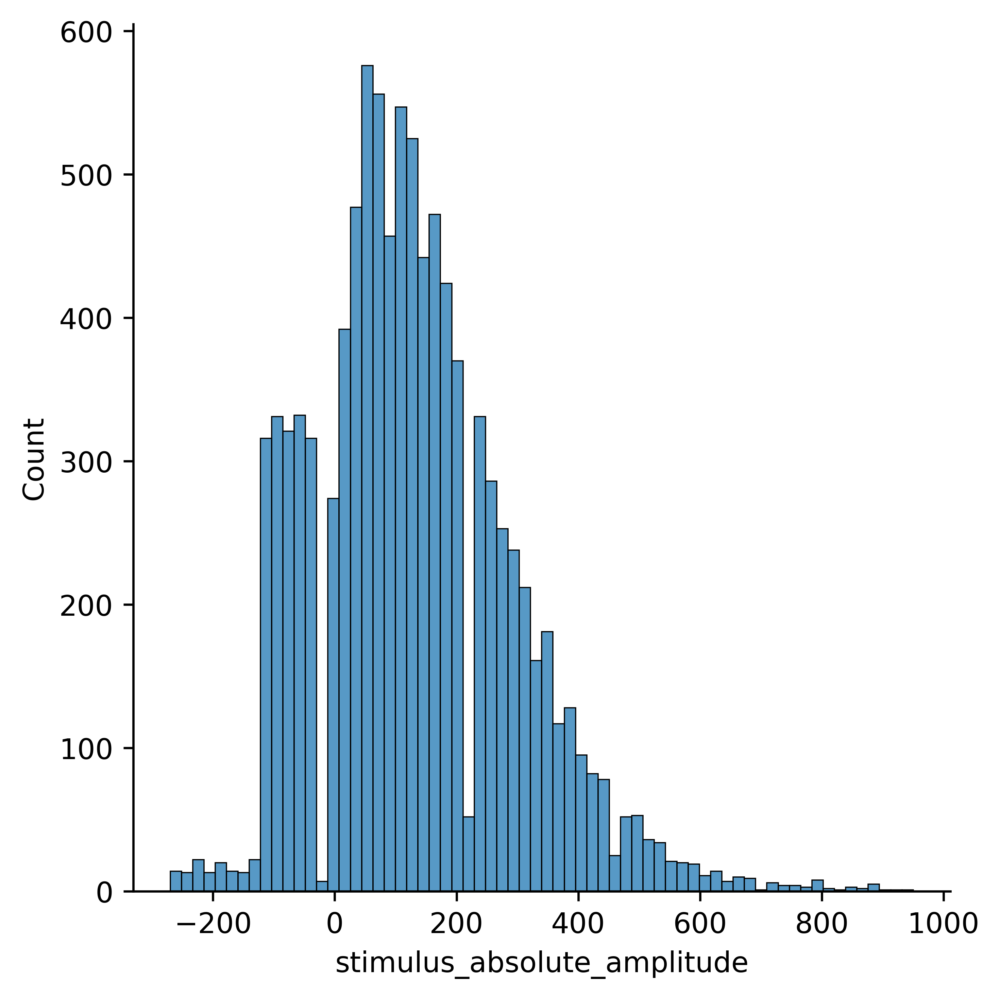

In [75]:
sns.displot(ME_df['stimulus_absolute_amplitude'])

In [81]:
from math import isclose

In [153]:
stimulus_50_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],50,abs_tol=1):
            stimulus_50_df=stimulus_50_df.append(row,ignore_index=True)
            break 
stimulus_50_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,3201.767269,366.389074,66.502321,NaN,0.816475,0.454295,52.972222,1.000000,0.050274,...,385.0,0.0,1.00002,42.0,NaN,sparsely spiny,3D Neuron Reconstruction morphology,CCN201906170,2243.544657,249.436654
1,Mouse,3077.924198,287.670058,91.555459,NaN,0.863968,0.375704,44.804348,0.987527,0.062153,...,385.0,0.0,NaN,37.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2607.623334,213.171765
2,Mouse,3883.698604,512.836253,62.163118,NaN,0.930364,0.464887,59.486486,0.858529,0.067000,...,409.0,0.0,NaN,30.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2644.878298,119.629705
3,Mouse,3849.878219,647.380020,80.156906,NaN,0.885432,0.643432,36.659091,0.996254,0.062875,...,385.0,0.0,3.00006,26.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,1898.964752,171.469234
4,Mouse,3225.087781,362.289231,63.299816,NaN,0.860777,0.444784,52.083333,0.995482,0.056125,...,385.0,0.0,1.00002,24.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2310.956909,152.238796
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319,Human,2037.560137,107.626504,83.285868,NaN,0.908488,0.187571,90.031250,0.890005,0.063669,...,12117.0,0.0,NaN,31.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3462.933474,NaN
320,Human,5834.449810,839.754965,89.144036,NaN,0.782799,0.553199,141.250000,0.989965,0.095622,...,12141.0,0.0,NaN,30.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3343.430184,NaN
321,Human,3399.055590,696.283725,67.081072,NaN,0.935039,0.783493,94.916667,0.993377,0.083322,...,12141.0,0.0,NaN,38.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,1377.917561,NaN
322,Human,17235.751114,2816.489066,74.810953,NaN,0.902714,0.584132,90.811765,0.976552,0.381681,...,12141.0,0.0,NaN,58.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,9312.766868,NaN


In [158]:
stimulus_50_df.to_csv('../result/one_50pA_stimulus_per_neuron.tsv',sep='\t')

In [104]:
stimulus_150_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],150,abs_tol=1):
            stimulus_150_df=stimulus_150_df.append(row,ignore_index=True)
            break 
stimulus_150_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,3201.767269,366.389074,66.502321,NaN,0.816475,0.454295,52.972222,1.000000,0.050274,...,385.0,0.0,3.000060,36.0,NaN,sparsely spiny,3D Neuron Reconstruction morphology,CCN201906170,2243.544657,249.436654
1,Mouse,3077.924198,287.670058,91.555459,NaN,0.863968,0.375704,44.804348,0.987527,0.062153,...,385.0,0.0,NaN,42.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2607.623334,213.171765
2,Mouse,3883.698604,512.836253,62.163118,NaN,0.930364,0.464887,59.486486,0.858529,0.067000,...,409.0,0.0,23.000115,35.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2644.878298,119.629705
3,Mouse,3457.664890,296.376912,80.726557,NaN,0.833295,0.332183,47.037037,1.000000,0.089168,...,385.0,0.0,1.000020,41.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,3315.341024,227.568322
4,Mouse,3225.087781,362.289231,63.299816,NaN,0.860777,0.444784,52.083333,0.995482,0.056125,...,385.0,0.0,6.000120,29.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2310.956909,152.238796
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,Human,13292.316923,1911.877717,67.998524,NaN,0.917772,0.469861,51.136986,0.898237,0.448978,...,12141.0,0.0,10.000200,37.0,truncated,spiny,3D Neuron Reconstruction morphology,NaN,9017.137451,NaN
296,Human,2037.560137,107.626504,83.285868,NaN,0.908488,0.187571,90.031250,0.890005,0.063669,...,12117.0,0.0,3.000060,46.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3462.933474,NaN
297,Human,5834.449810,839.754965,89.144036,NaN,0.782799,0.553199,141.250000,0.989965,0.095622,...,12141.0,0.0,22.000440,35.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3343.430184,NaN
298,Human,3399.055590,696.283725,67.081072,NaN,0.935039,0.783493,94.916667,0.993377,0.083322,...,12141.0,0.0,20.000400,43.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,1377.917561,NaN


In [143]:
stimulus_150_df.to_csv('../result/one_150pA_stimulus_per_neuron.tsv',sep='\t')

In [101]:
stimulus_150_df['sweep_FR']

0       3.000060
1            NaN
2      23.000115
3       1.000020
4       6.000120
         ...    
295    10.000200
296     3.000060
297    22.000440
298    20.000400
299          NaN
Name: sweep_FR, Length: 300, dtype: float64

In [103]:
stimulus_250_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],250,abs_tol=1):
            stimulus_250_df=stimulus_250_df.append(row,ignore_index=True)
            break 
stimulus_250_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,3077.924198,287.670058,91.555459,NaN,0.863968,0.375704,44.804348,0.987527,0.062153,...,385.0,0.0,NaN,47.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2607.623334,213.171765
1,Mouse,3883.698604,512.836253,62.163118,NaN,0.930364,0.464887,59.486486,0.858529,0.067000,...,409.0,0.0,62.000310,40.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2644.878298,119.629705
2,Human,4289.961763,547.046601,71.934852,NaN,0.926564,0.482867,85.607143,0.931743,0.065348,...,12117.0,0.0,NaN,41.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,2818.027682,NaN
3,Mouse,979.330116,35.713919,64.041875,NaN,0.900890,0.143875,48.750000,0.959256,0.063006,...,385.0,0.0,29.000145,58.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2163.100262,227.751744
4,Mouse,1783.695633,215.272594,98.794227,NaN,0.874339,0.483152,46.300000,0.998800,0.046621,...,385.0,0.0,2.000040,37.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,1178.221189,203.329521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,Mouse,1645.638196,98.307476,68.658889,NaN,0.893606,0.243099,25.531250,1.000000,0.062748,...,385.0,0.0,NaN,39.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2148.380228,136.610462
178,Mouse,2197.279247,142.576273,78.840103,NaN,0.884016,0.263790,54.950000,0.998834,0.080133,...,385.0,0.0,NaN,43.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2651.212000,229.334865
179,Human,2037.560137,107.626504,83.285868,NaN,0.908488,0.187571,90.031250,0.890005,0.063669,...,12117.0,0.0,28.000560,41.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3462.933474,NaN
180,Human,3399.055590,696.283725,67.081072,NaN,0.935039,0.783493,94.916667,0.993377,0.083322,...,12141.0,0.0,60.001200,48.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,1377.917561,NaN


In [144]:
stimulus_250_df.to_csv('../result/one_250pA_stimulus_per_neuron.tsv',sep='\t')

In [105]:
stimulus_250_df['sweep_FR']

0            NaN
1      62.000310
2            NaN
3      29.000145
4       2.000040
         ...    
177          NaN
178          NaN
179    28.000560
180    60.001200
181    82.001640
Name: sweep_FR, Length: 182, dtype: float64

In [148]:
stimulus_200_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],200,abs_tol=1):
            stimulus_200_df=stimulus_200_df.append(row,ignore_index=True)
            break 
stimulus_200_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,1783.695633,215.272594,98.794227,NaN,0.874339,0.483152,46.300000,0.998800,0.046621,...,385.0,0.0,NaN,44.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,1178.221189,203.329521
1,Mouse,415.401981,7.024580,78.977096,NaN,0.840310,0.079869,33.500000,0.991300,0.047325,...,385.0,0.0,63.001260,60.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,1655.417631,135.889873
2,Human,13365.538545,2414.429997,85.995836,NaN,0.888314,0.675817,138.868421,0.944125,0.147752,...,12141.0,0.0,NaN,63.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,6290.113213,NaN
3,Human,14073.011570,2360.923499,62.622131,NaN,0.869741,0.573912,81.325000,0.991725,0.280232,...,12141.0,0.0,NaN,59.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,7640.874006,NaN
4,Mouse,4938.223815,750.970273,74.274521,NaN,0.855662,0.576755,54.261905,1.000000,0.087494,...,385.0,0.0,NaN,50.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2721.309048,118.862092
5,Human,9995.692287,1653.593962,65.857901,NaN,0.912524,0.575189,87.173077,0.991600,0.184873,...,12141.0,0.0,1.000020,63.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,5445.573833,NaN
6,Mouse,2344.272968,202.453236,76.825044,NaN,0.891644,0.323042,39.260870,1.007622,0.063635,...,385.0,0.0,44.000220,58.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2313.541473,146.900098
7,Mouse,402.242787,4.309842,82.173075,NaN,0.914006,0.053899,34.214286,0.998989,0.060062,...,385.0,0.0,7.000140,56.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2376.377170,225.098977
8,Human,11831.043518,2185.157978,68.681768,NaN,0.921452,0.623816,75.358209,0.991551,0.251671,...,12141.0,0.0,18.000360,62.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,5905.677229,NaN
9,Human,14829.543369,2489.415261,71.901825,NaN,0.833180,0.592176,84.587500,1.000000,0.281789,...,12141.0,0.0,1.000020,56.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,7970.058798,NaN


In [149]:
stimulus_100_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],100,abs_tol=1):
            stimulus_100_df=stimulus_100_df.append(row,ignore_index=True)
            break 
stimulus_100_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,3457.664890,296.376912,80.726557,NaN,0.833295,0.332183,47.037037,1.000000,0.089168,...,385.0,0.0,1.000020,50.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,3315.341024,227.568322
1,Human,21813.035547,4362.864076,80.198475,NaN,0.903792,0.757992,110.941176,1.000000,0.240162,...,12141.0,0.0,1.000020,61.0,truncated,spiny,3D Neuron Reconstruction morphology,NaN,9145.308474,NaN
2,Human,18722.549750,6151.897747,72.247087,NaN,0.861408,0.813307,117.346154,0.890828,0.187084,...,12141.0,0.0,5.000100,39.0,truncated,spiny,3D Neuron Reconstruction morphology,NaN,7284.819454,NaN
3,Human,18270.390877,3178.837876,72.273272,NaN,0.895998,0.602059,64.167939,0.798919,0.229087,...,12141.0,0.0,NaN,60.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,9657.544889,NaN
4,Mouse,4621.600042,618.725628,72.017576,NaN,0.930489,0.515843,58.261905,0.987560,0.068226,...,385.0,0.0,NaN,38.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2852.072949,163.365090
5,Mouse,6130.743582,941.113544,66.960928,NaN,0.861651,0.570774,67.045455,0.966491,0.163622,...,385.0,0.0,13.000260,50.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,3416.968777,100.991618
6,Human,11625.910380,1738.443525,72.229639,NaN,0.924011,0.528983,61.760870,0.964435,0.148059,...,12142.0,0.0,NaN,70.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,6868.615097,NaN
7,Human,22232.394858,5100.360466,67.661994,NaN,0.902507,0.757466,77.722772,0.942601,0.200647,...,12141.0,0.0,2.000040,24.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,9336.919982,NaN
8,Human,6036.338389,841.237745,68.766861,NaN,0.848380,0.550347,92.714286,1.000000,0.123889,...,12141.0,0.0,8.000160,54.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,3491.345240,NaN
9,Human,1182.334813,167.961074,77.740770,NaN,0.931994,0.549596,55.500000,0.958536,0.039187,...,12147.0,0.0,91.001820,44.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,684.365414,NaN


In [150]:
stimulus_300_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],300,abs_tol=1):
            stimulus_300_df=stimulus_300_df.append(row,ignore_index=True)
            break 
stimulus_300_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,2684.481049,221.416676,84.021129,NaN,0.868647,0.324718,43.560000,1.007640,0.084115,...,533.0,0.0,NaN,56.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2632.576202,221.434050
1,Human,17180.054354,3554.605315,84.245835,NaN,0.810554,0.741808,79.662500,0.951286,0.415706,...,12139.0,0.0,1.00002,89.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,7367.737043,NaN
2,Human,18026.218425,1721.228798,72.929099,NaN,0.911064,0.357642,94.312500,0.948673,0.455474,...,12141.0,0.0,NaN,83.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,16051.870779,NaN
3,Human,22232.394858,5100.360466,67.661994,NaN,0.902507,0.757466,77.722772,0.942601,0.200647,...,12141.0,0.0,27.00054,29.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,9336.919982,NaN
4,Mouse,4217.745382,533.313936,74.605424,NaN,0.881888,0.485300,58.210526,0.928945,0.089591,...,385.0,0.0,NaN,60.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2763.765285,216.502441
5,Mouse,6414.673716,604.937112,68.065251,NaN,0.866650,0.372487,40.517857,0.997994,0.273248,...,385.0,0.0,8.00016,74.0,intact,spiny,3D Neuron Reconstruction morphology,CCN201906170,5472.333123,213.908833
6,Human,11831.043518,2185.157978,68.681768,NaN,0.921452,0.623816,75.358209,0.991551,0.251671,...,12141.0,0.0,33.00066,46.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,5905.677229,NaN
7,Human,25687.712065,3912.667582,74.569053,NaN,0.892567,0.564407,92.023077,0.974234,0.396221,...,12141.0,0.0,22.00044,46.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,14488.033454,NaN
8,Human,17157.149699,4385.239342,65.234639,NaN,0.871301,0.854988,132.057143,0.947752,0.123423,...,12139.0,0.0,2.00004,61.0,NaN,aspiny,3D Neuron Reconstruction morphology,NaN,6040.451640,NaN
9,Mouse,4253.349444,702.403309,85.751453,NaN,0.899746,0.633833,44.921053,0.990685,0.078807,...,385.0,0.0,71.00142,54.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2132.069363,197.110445


In [151]:
stimulus_350_df=pd.DataFrame()
for specimen_id in set(ME_df.specimen_id):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    for index, row in df.iterrows():
        if isclose(row['stimulus_absolute_amplitude'],350,abs_tol=1):
            stimulus_350_df=stimulus_350_df.append(row,ignore_index=True)
            break 
stimulus_350_df

,Species,Vaa3D_surface,Vaa3D_volume,average_bifurcation_angle_local,average_bifurcation_angle_remote,average_contraction,average_diameter,average_fragmentation,average_parent_daughter_ratio,capacitance,...,structure_parent__id,superseded,sweep_FR,sweep_number,tag__apical,tag__dendrite_type,tags,taxonomy_id,total_length,upright_angle
0,Mouse,3077.924198,287.670058,91.555459,NaN,0.863968,0.375704,44.804348,0.987527,0.062153,...,385.0,0.0,5.000100,52.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2607.623334,213.171765
1,Mouse,979.330116,35.713919,64.041875,NaN,0.900890,0.143875,48.750000,0.959256,0.063006,...,385.0,0.0,95.000475,55.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2163.100262,227.751744
2,Mouse,1783.695633,215.272594,98.794227,NaN,0.874339,0.483152,46.300000,0.998800,0.046621,...,385.0,0.0,134.002680,42.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,1178.221189,203.329521
3,Mouse,1225.438694,46.034536,69.651256,NaN,0.910643,0.147192,31.343284,0.882169,0.102946,...,385.0,0.0,4.000020,69.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2650.552408,225.564312
4,Mouse,2326.278506,188.047373,84.566685,NaN,0.914024,0.317193,51.472222,0.914498,0.075499,...,385.0,0.0,NaN,46.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2335.830949,165.768564
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101,Human,13613.905841,2235.822404,76.792844,NaN,0.816045,0.600176,71.817073,0.978339,0.245615,...,12139.0,0.0,13.000260,50.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,7222.247825,NaN
102,Mouse,2710.985337,258.158887,85.159021,NaN,0.920437,0.340335,59.750000,0.834130,0.106214,...,385.0,0.0,NaN,55.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2530.306598,146.801916
103,Human,15725.530598,2946.257220,84.951203,NaN,0.859646,0.659220,71.022727,0.979625,0.323272,...,12113.0,0.0,2.000040,62.0,intact,spiny,3D Neuron Reconstruction morphology,NaN,7587.058047,NaN
104,Mouse,1645.638196,98.307476,68.658889,NaN,0.893606,0.243099,25.531250,1.000000,0.062748,...,385.0,0.0,49.000980,44.0,NaN,aspiny,3D Neuron Reconstruction morphology,CCN201906170,2148.380228,136.610462


In [165]:
for column in stimulus_100_df.columns:
    print(column)

Species
Vaa3D_surface
Vaa3D_volume
average_bifurcation_angle_local
average_bifurcation_angle_remote
average_contraction
average_diameter
average_fragmentation
average_parent_daughter_ratio
capacitance
cell_reporter_status
cell_set_  additional_alias
cell_set_ accession
cell_set_ alias_assignee
cell_set_ alias_citation
cell_set_ aligned_alias
cell_set_ label
cell_set_ ontology_tag
cell_set_ structure
cell_set_preferred_alias
csl__normalized_depth
csl__x
csl__y
csl__z
donor__age
donor__disease_state
donor__id
donor__name
donor__race
donor__sex
donor__species
donor__years_of_seizure_history
e-type
ef__adaptation
ef__avg_firing_rate
ef__avg_isi
ef__f_i_curve_slope
ef__fast_trough_v_long_square
ef__peak_t_ramp
ef__ri
ef__tau
ef__threshold_i_long_square
ef__upstroke_downstroke_ratio_long_square
ef__vrest
ephys_inst_thresh_thumb_path
ephys_thumb_path
erwkf__id
estimated_shrinkage_factor
estimated_slice_angle
hausdorff_dimension
id
line_name
m-type
m__biophys
m__biophys_all_active
m__biophys_p

In [157]:
stimulus_350_df.to_csv('../result/one_350pA_stimulus_per_neuron.tsv',sep='\t')

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

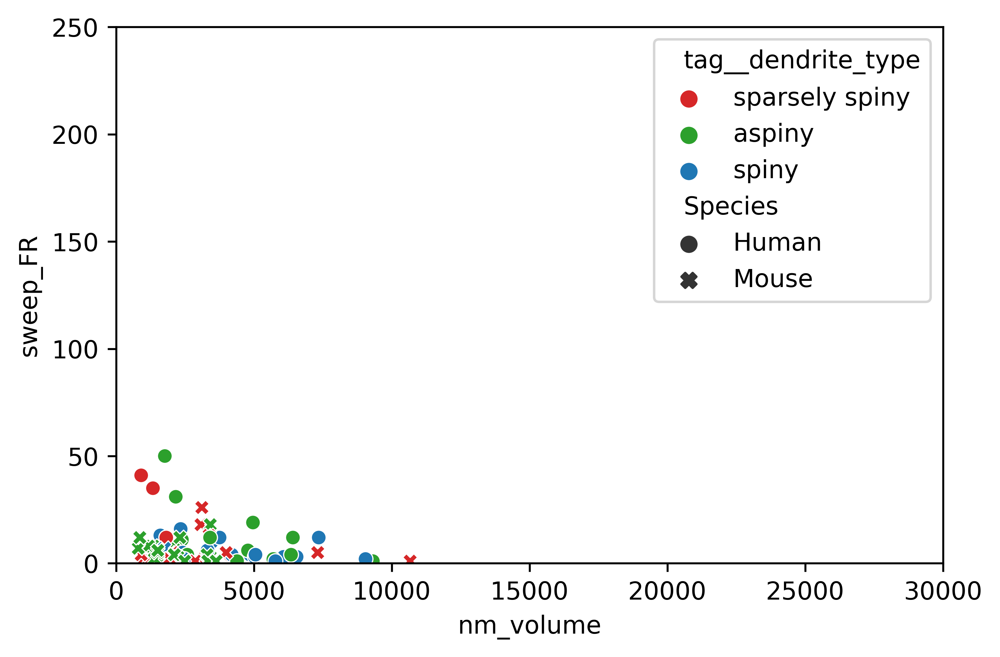

In [159]:
plt.xlim(0, 30000)
plt.ylim(0, 250)
sns.scatterplot(data=stimulus_50_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

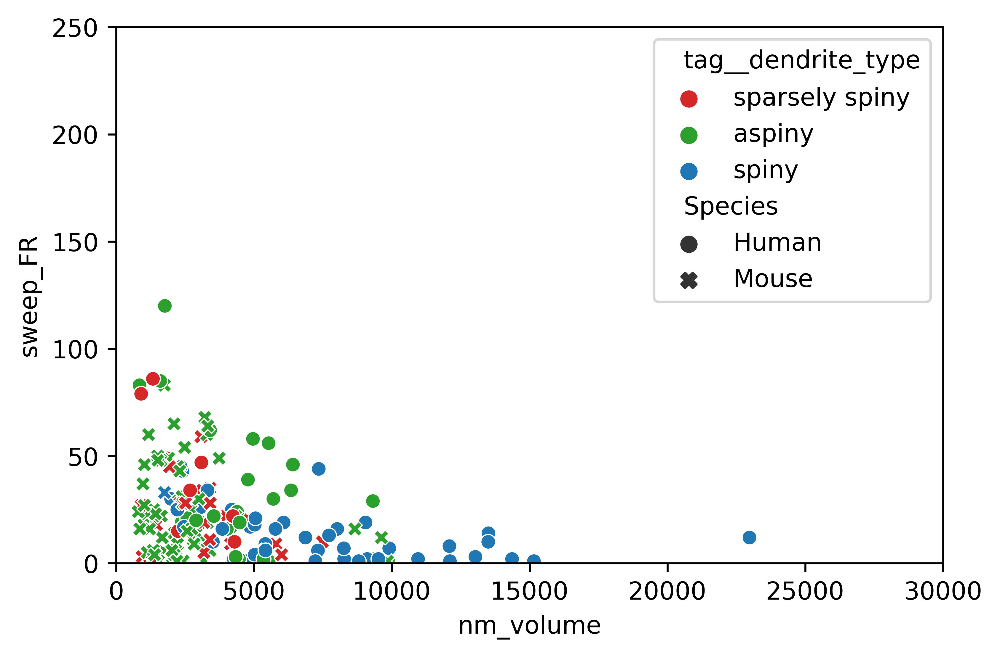

In [160]:
plt.xlim(0, 30000)
plt.ylim(0, 250)
sns.scatterplot(data=stimulus_150_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [114]:
pg.corr(stimulus_150_df['nm_volume'], stimulus_150_df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,172,-0.314952,"[-0.44, -0.17]",0.099195,0.088534,0.000026,0.988979


In [115]:
df=stimulus_150_df[stimulus_150_df['tag__dendrite_type']=='spiny']
pg.corr(df['nm_volume'], df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,47,-0.597614,"[-0.76, -0.37]",0.357142,0.327921,0.000009,0.996016


In [116]:
df=stimulus_150_df[stimulus_150_df['tag__dendrite_type']=='sparsely spiny']
pg.corr(df['nm_volume'], df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,30,-0.234639,"[-0.55, 0.14]",0.055056,-0.01494,0.212003,0.242281


In [117]:
df=stimulus_150_df[stimulus_150_df['tag__dendrite_type']=='aspiny']
pg.corr(df['nm_volume'], df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,95,-0.063316,"[-0.26, 0.14]",0.004009,-0.017643,0.542148,0.093544


<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

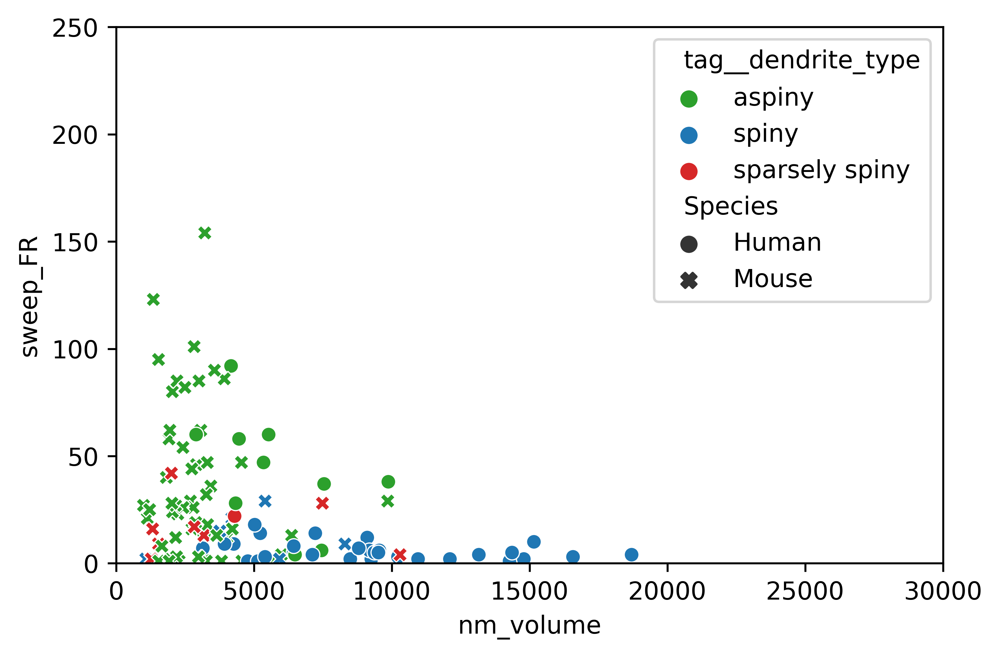

In [161]:
plt.xlim(0, 30000)
plt.ylim(0, 250)
sns.scatterplot(data=stimulus_250_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='sweep_FR'>

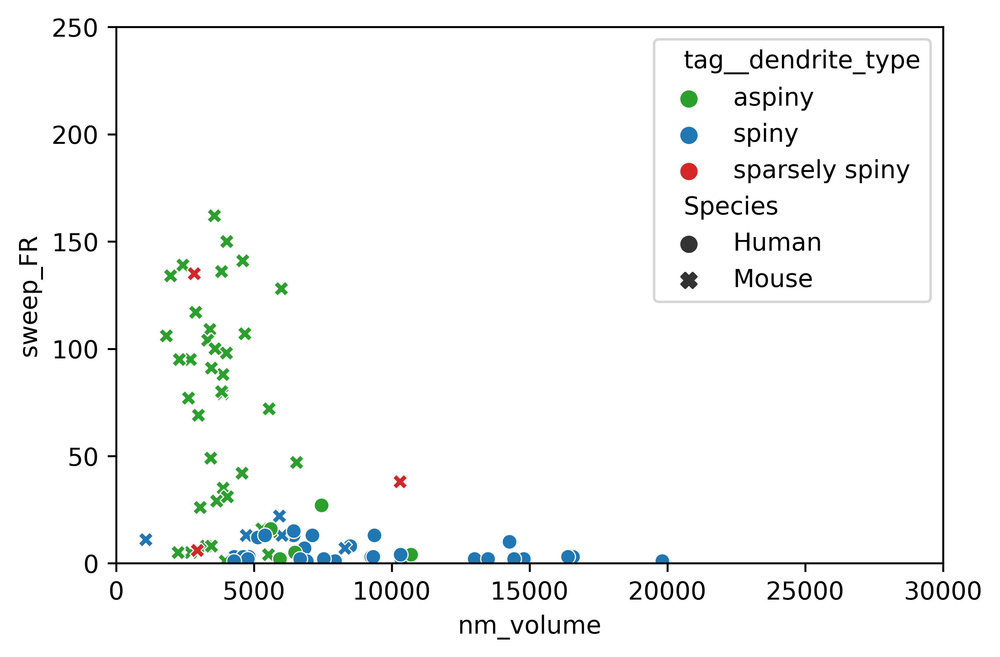

In [162]:
plt.xlim(0, 30000)
plt.ylim(0, 250)
sns.scatterplot(data=stimulus_350_df, x="nm_volume", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [118]:
from mpl_toolkits.mplot3d import Axes3D

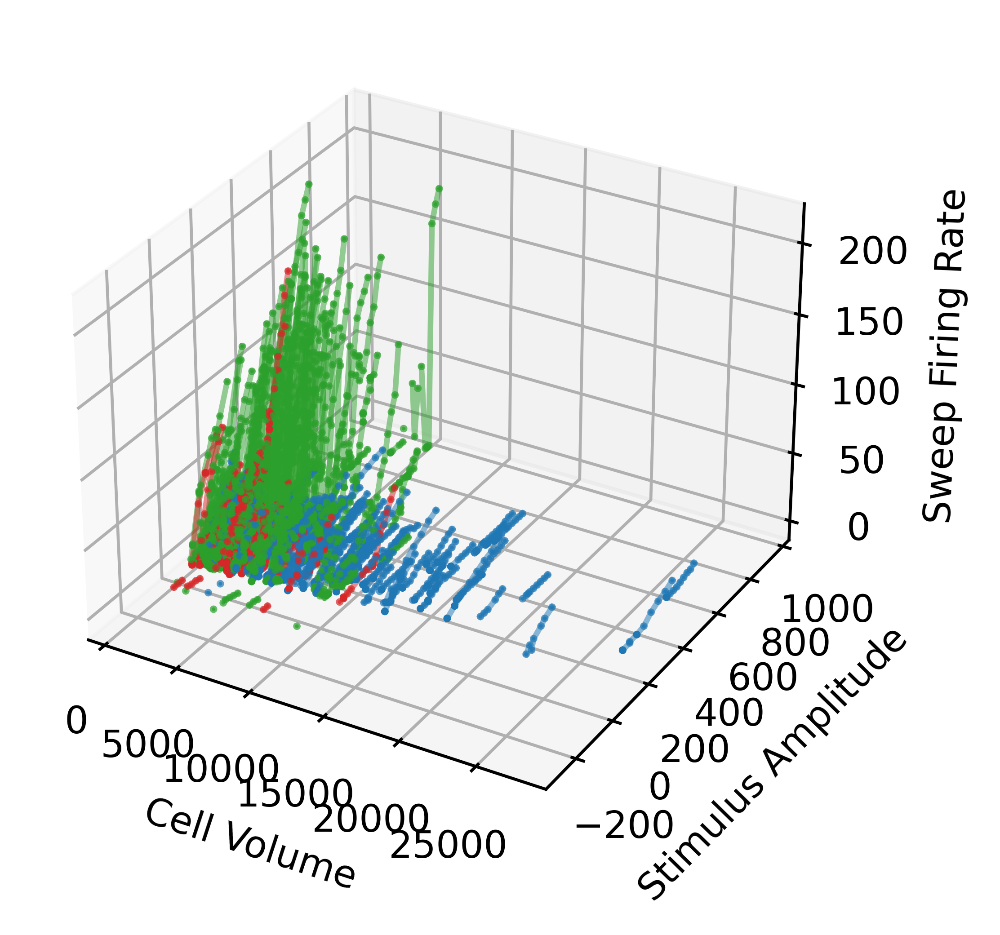

In [126]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for specimen_id in set(ME_df['specimen_id']):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    
    y = df['stimulus_absolute_amplitude']
    x = df['nm_volume']
    z = df['sweep_FR']
    
    if df['tag__dendrite_type'].iloc[0]=='spiny':
        color='tab:blue'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
        ax.plot(x,y,z,c=color,alpha=0.5)
    elif df['tag__dendrite_type'].iloc[0]=='sparsely spiny':
        color='tab:red'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
        ax.plot(x,y,z,c=color,alpha=0.5)
    elif df['tag__dendrite_type'].iloc[0]=='aspiny':
        color='tab:green'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
        ax.plot(x,y,z,c=color,alpha=0.5)

ax.set_ylabel('Stimulus Amplitude')
ax.set_xlabel('Cell Volume')
ax.set_zlabel('Sweep Firing Rate')

plt.show()

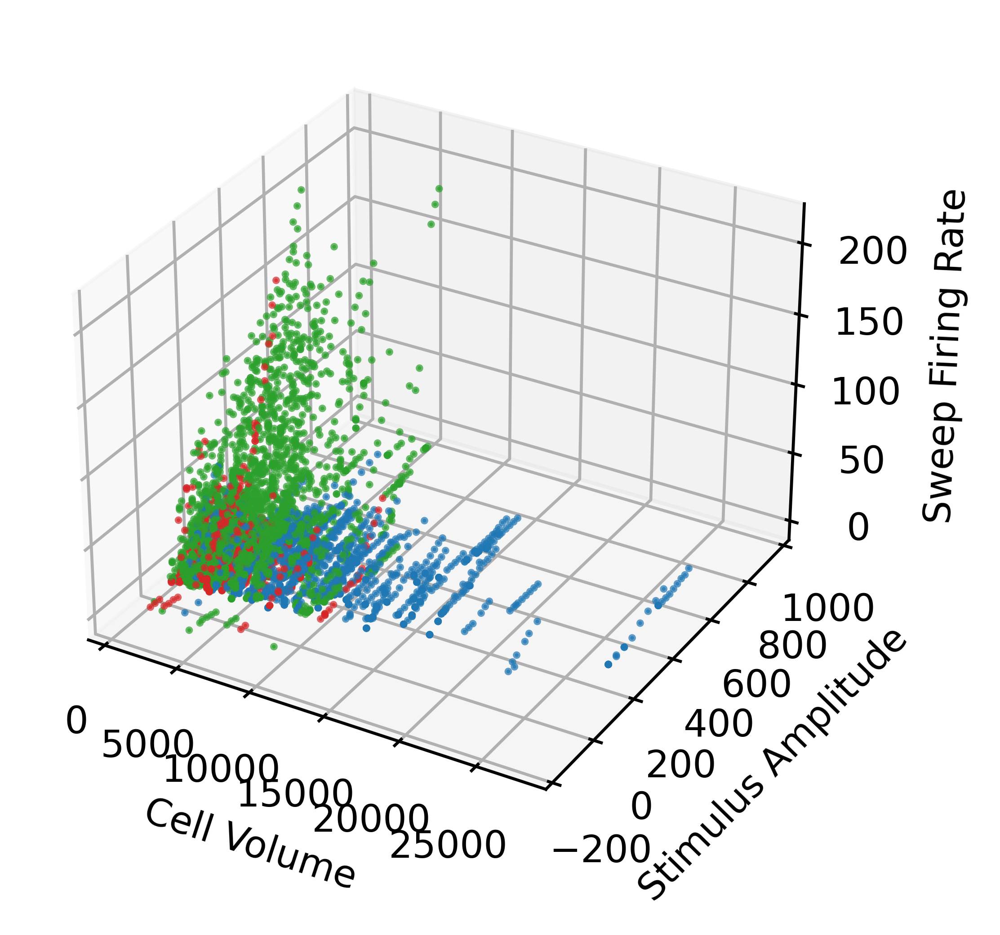

In [134]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for specimen_id in set(ME_df['specimen_id']):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    
    y = df['stimulus_absolute_amplitude']
    x = df['nm_volume']
    z = df['sweep_FR']
    
    if df['tag__dendrite_type'].iloc[0]=='spiny':
        color='tab:blue'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
#         ax.plot(x,y,z,c=color,alpha=0.5)
    elif df['tag__dendrite_type'].iloc[0]=='sparsely spiny':
        color='tab:red'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
#         ax.plot(x,y,z,c=color,alpha=0.5)
    elif df['tag__dendrite_type'].iloc[0]=='aspiny':
        color='tab:green'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
#         ax.plot(x,y,z,c=color,alpha=0.5)

ax.set_ylabel('Stimulus Amplitude')
ax.set_xlabel('Cell Volume')
ax.set_zlabel('Sweep Firing Rate')

plt.show()

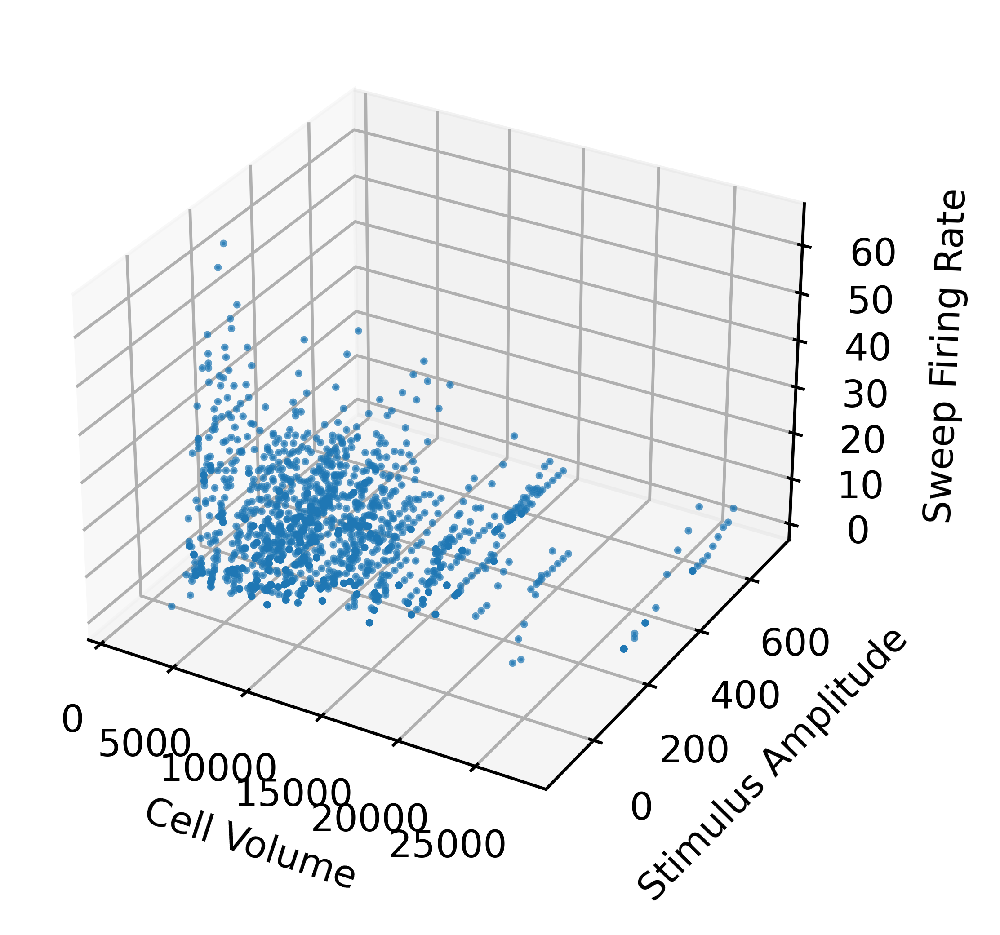

In [135]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for specimen_id in set(ME_df['specimen_id']):
    df = ME_df[ME_df['specimen_id']==specimen_id]
    df = df.sort_values(by=['stimulus_absolute_amplitude'])
    
    y = df['stimulus_absolute_amplitude']
    x = df['nm_volume']
    z = df['sweep_FR']
    
    if df['tag__dendrite_type'].iloc[0]=='spiny':
        color='tab:blue'
        ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
#     elif df['tag__dendrite_type'].iloc[0]=='sparsely spiny':
#         color='tab:red'
#         ax.scatter(x, y, z,s=1,c=color,alpha=0.7)
#     elif df['tag__dendrite_type'].iloc[0]=='aspiny':
#         color='tab:green'
#         ax.scatter(x, y, z,s=1,c=color,alpha=0.7)

ax.set_ylabel('Stimulus Amplitude')
ax.set_xlabel('Cell Volume')
ax.set_zlabel('Sweep Firing Rate')

plt.show()

<AxesSubplot:xlabel='capacitance', ylabel='sweep_FR'>

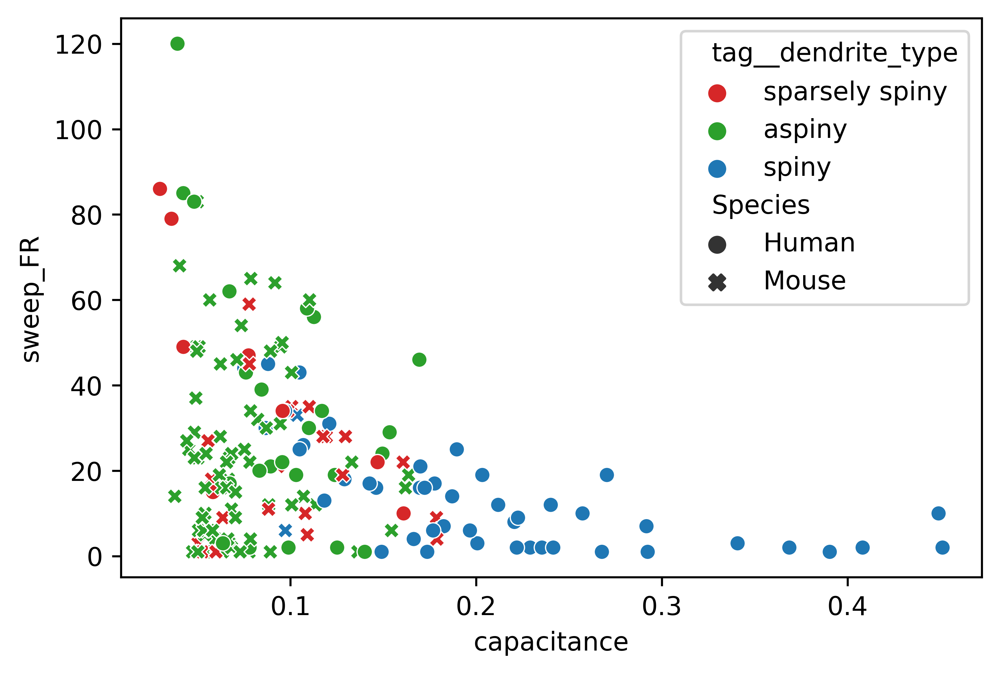

In [127]:
sns.scatterplot(data=stimulus_150_df, x="capacitance", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [128]:
pg.corr(stimulus_150_df['capacitance'], stimulus_150_df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,172,-0.295206,"[-0.43, -0.15]",0.087147,0.076344,0.000084,0.977564


In [131]:
df=stimulus_150_df[stimulus_150_df['tag__dendrite_type']=='sparsely spiny']
pg.corr(df['capacitance'], df['sweep_FR'],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,30,-0.208593,"[-0.53, 0.16]",0.043511,-0.02734,0.268645,0.199896


<AxesSubplot:xlabel='ef__tau', ylabel='sweep_FR'>

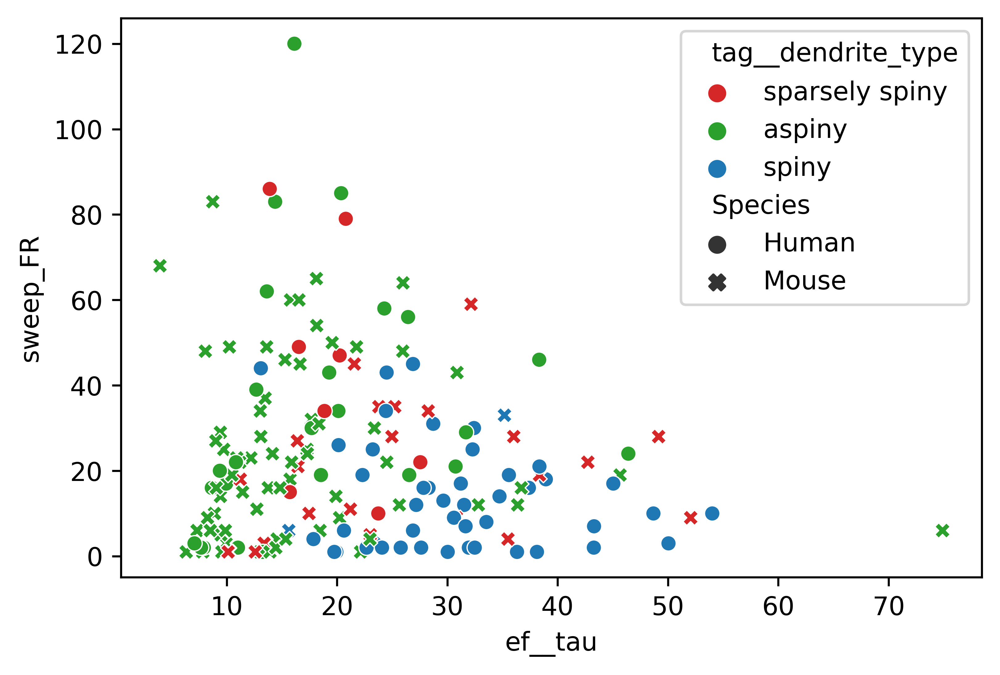

In [132]:
sns.scatterplot(data=stimulus_150_df, x="ef__tau", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__ri', ylabel='sweep_FR'>

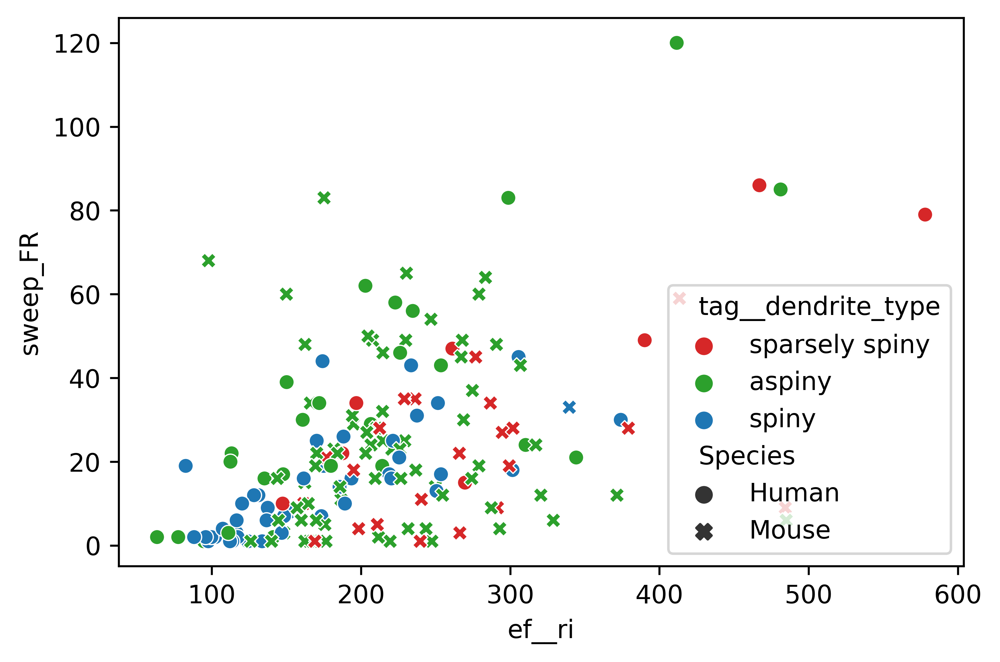

In [133]:
sns.scatterplot(data=stimulus_150_df, x="ef__ri", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__ri', ylabel='capacitance'>

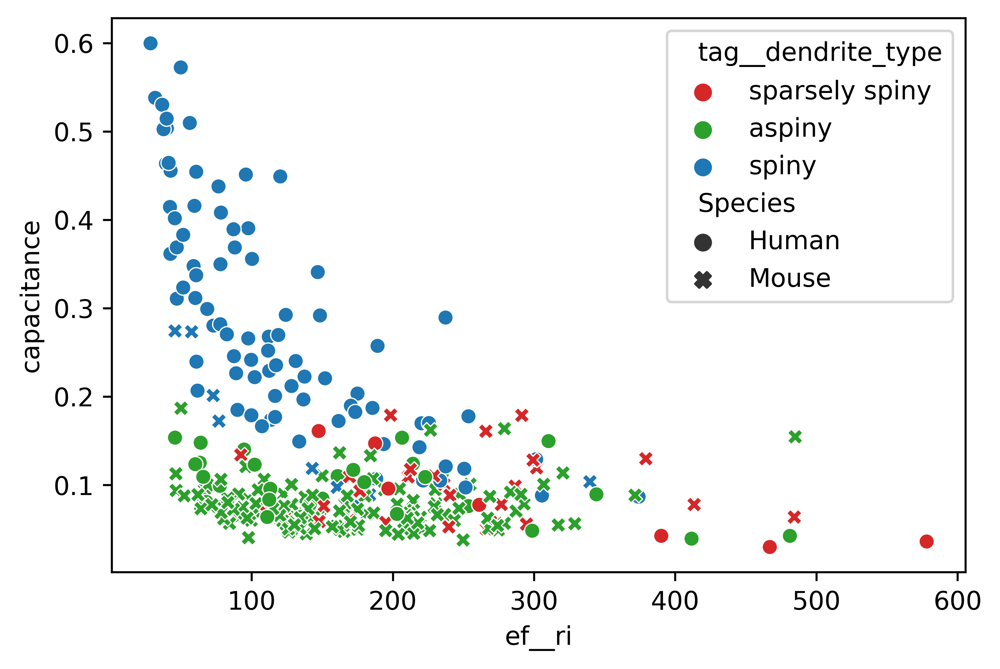

In [136]:
sns.scatterplot(data=stimulus_150_df, x="ef__ri", y="capacitance", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__tau', ylabel='capacitance'>

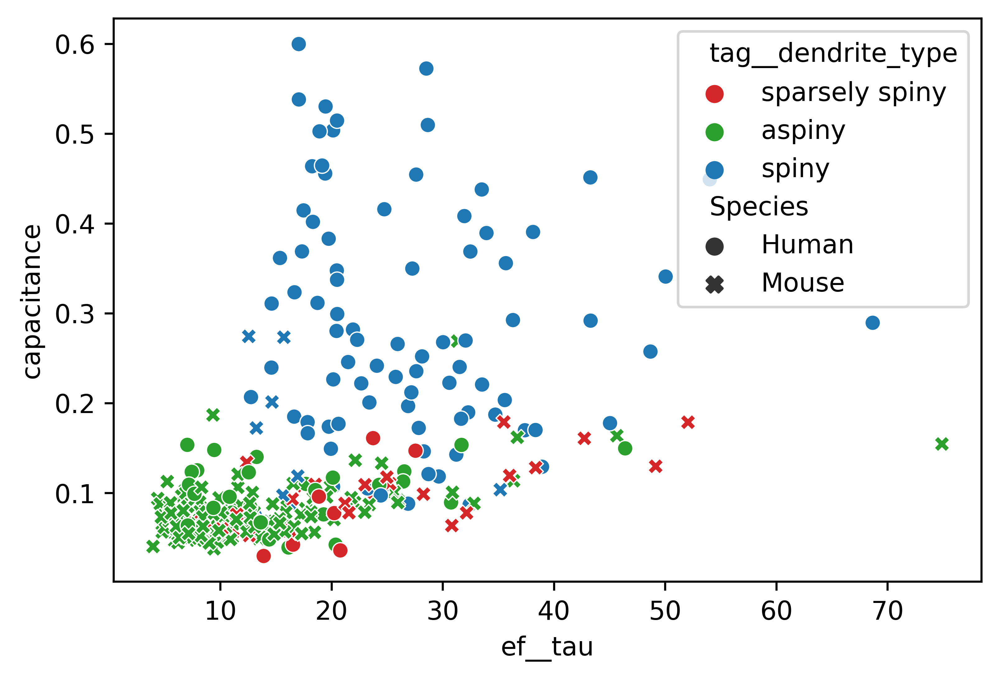

In [137]:
sns.scatterplot(data=stimulus_150_df, x="ef__tau", y="capacitance", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='ef__vrest', ylabel='sweep_FR'>

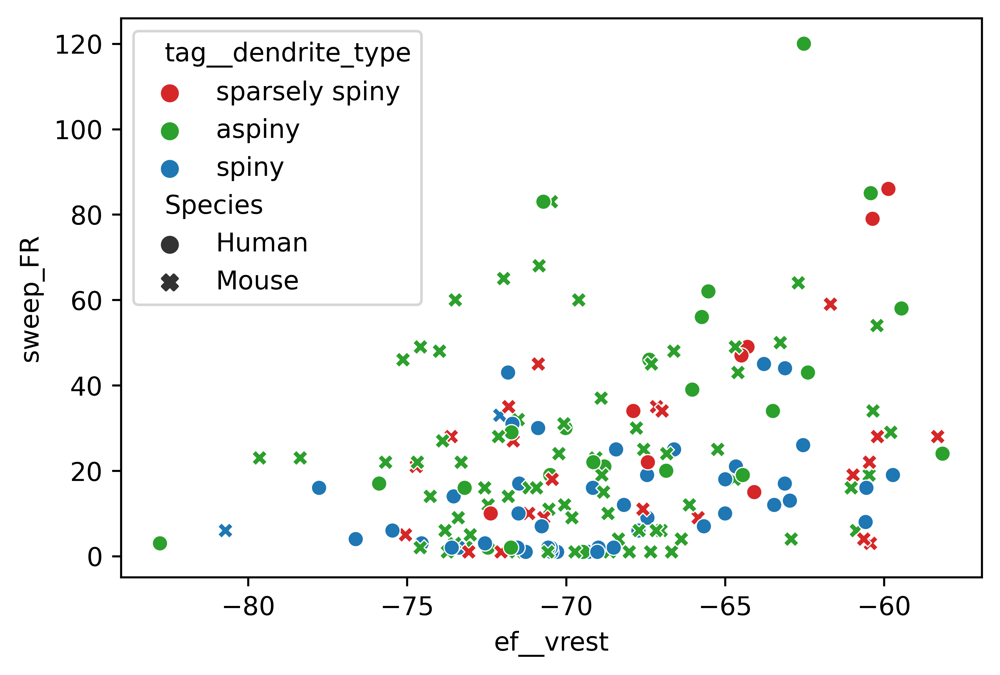

In [138]:
sns.scatterplot(data=stimulus_150_df, x="ef__vrest", y="sweep_FR", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

<AxesSubplot:xlabel='nm_volume', ylabel='Count'>

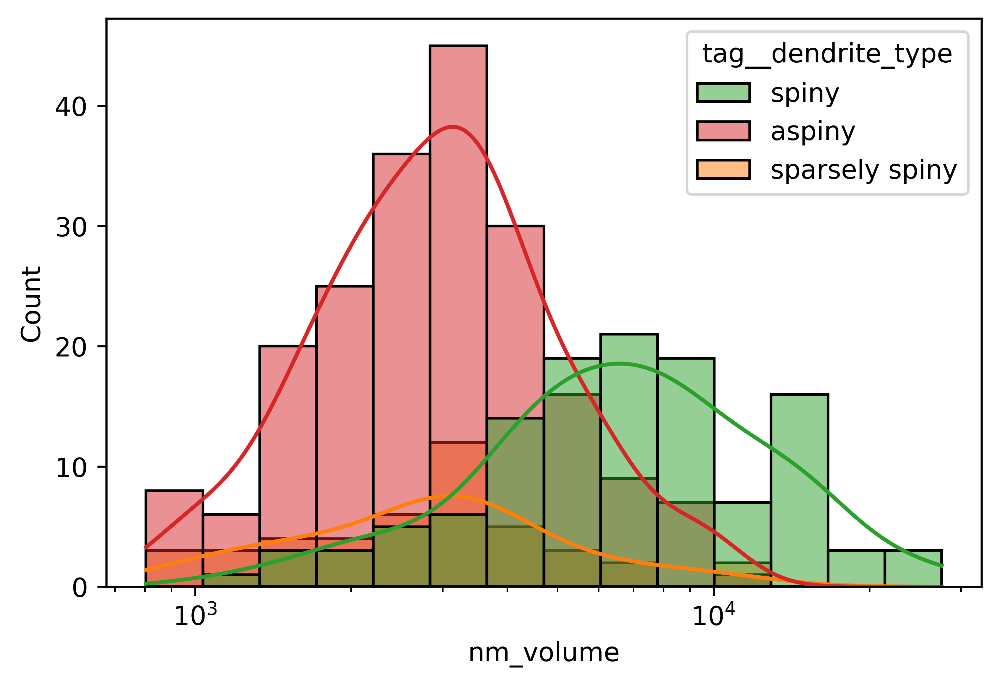

In [207]:
fig, ax = plt.subplots()
ax.set(xscale="log")
sns.histplot(ax=ax,data=max_FR_df,x='nm_volume', hue='tag__dendrite_type',kde=True,palette=palette)

In [167]:
pd.set_option('display.max_columns', 110)

In [181]:
ME_df[['Species','specimen_id','structure__name','structure__layer']].drop_duplicates()['structure__layer'].value_counts()

2/3    83
5      78
3      78
4      44
6a     32
1      20
2      19
6       9
6b      4
Name: structure__layer, dtype: int64

In [188]:
len(set(ME_df['specimen_id']))

367

In [189]:
len(max_FR_df['specimen_id'])

367

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, data. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


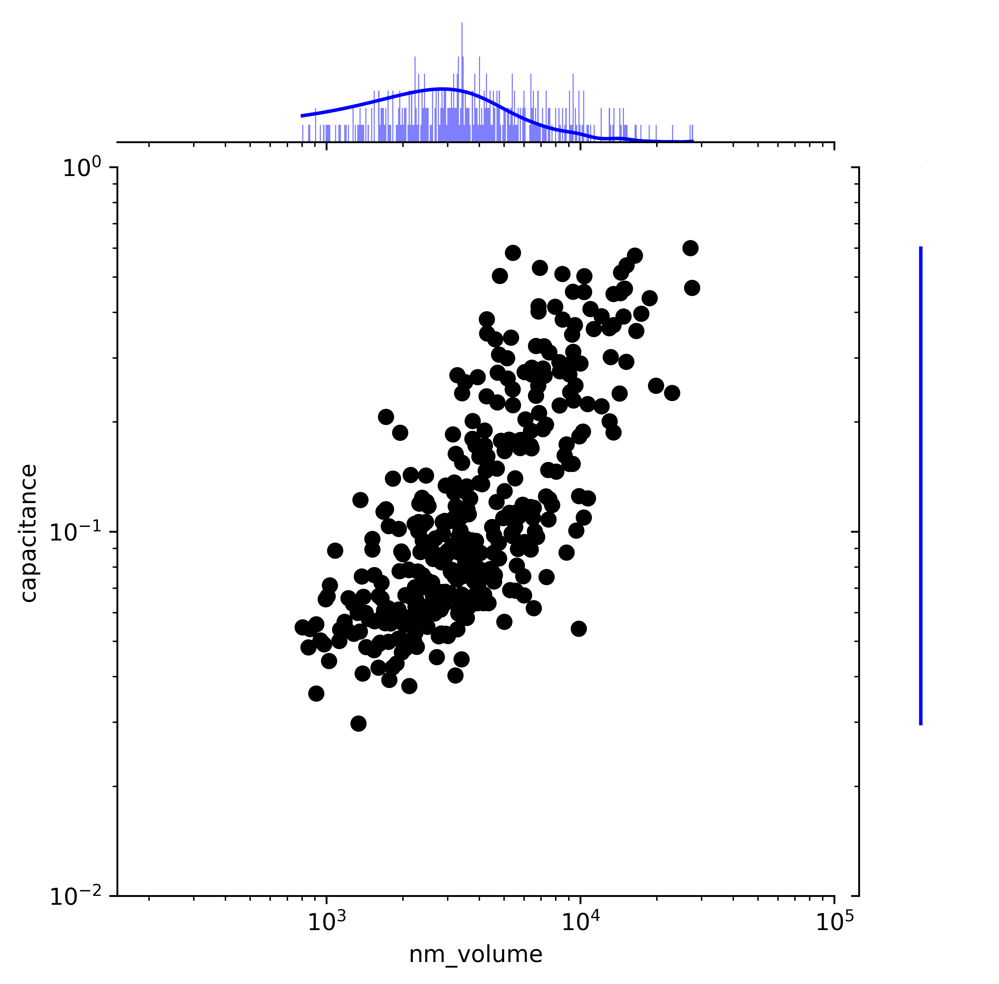

In [230]:
mybins=np.logspace(0,np.log(100),1000)
g = sns.JointGrid('nm_volume', 'capacitance', max_FR_df,xlim=[150,100000],ylim=[0.01,1])
g.plot_marginals(sns.histplot, kde=True, color='blue',bins=mybins)
g.plot_joint(plt.scatter, color='black', edgecolor='black')
ax = g.ax_joint
ax.set_xscale('log')
ax.set_yscale('log')
g.ax_marg_x.set_xscale('log')
g.ax_marg_y.set_yscale('log')

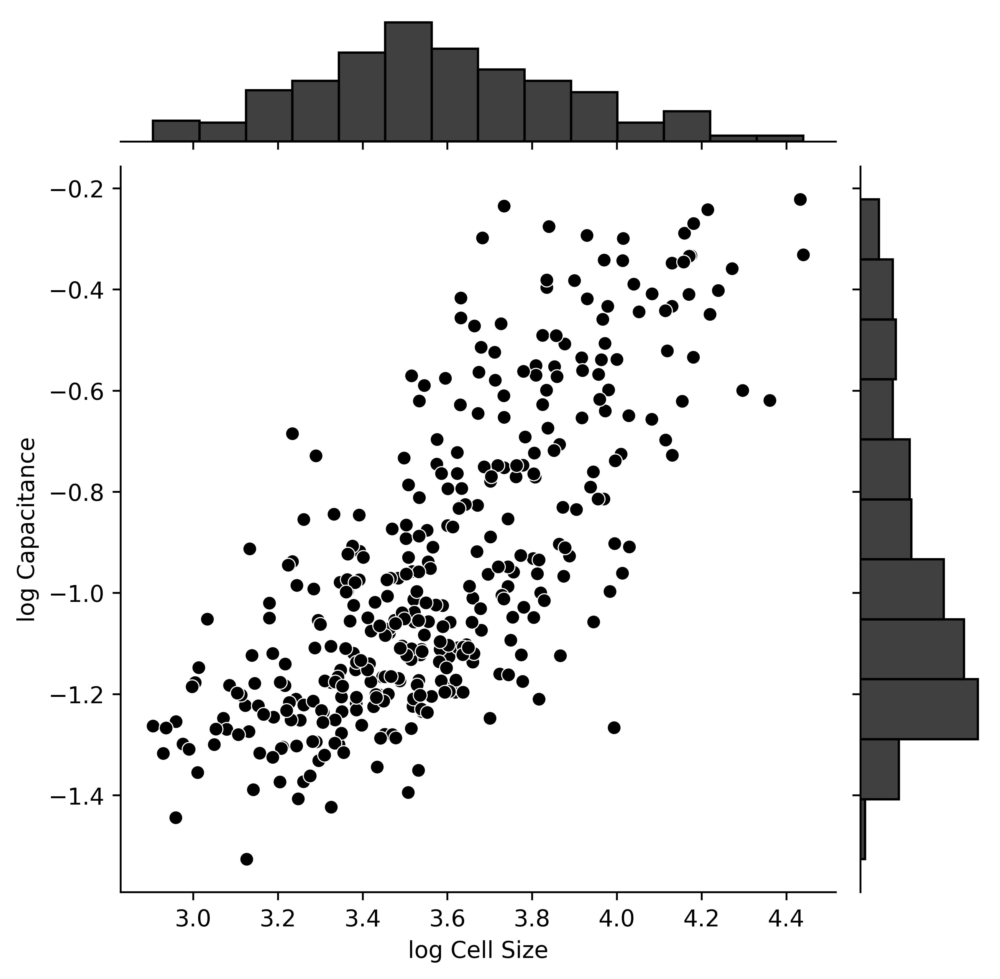

In [246]:
# fig, ax = plt.subplots()
# ax.set(xscale="log")
# sns.scatterplot(data=max_FR_df, x="nm_volume", y="capacitance", )
# grid = sns.jointplot(data=max_FR_df,x="nm_volume", y="capacitance",kind='reg',color='grey')
# grid.ax_joint.set_xscale('log')
# grid.ax_joint.set_yscale('log')
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=np.log10(max_FR_df["capacitance"]),color='black')
grid.set_axis_labels('log Cell Size', 'log Capacitance')
# grid.ax_marg_x.set_xscale('log')
# grid.ax_marg_y.set_yscale('log')

In [250]:
pg.linear_regression(np.log10(max_FR_df["nm_volume"]), np.log10(max_FR_df["capacitance"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-3.554751,0.121030,-29.370797,3.625444e-98,0.560688,0.559484,-3.792755,-3.316747
1,nm_volume,0.727350,0.033699,21.583422,3.559137e-67,0.560688,0.559484,0.661081,0.793620


In [251]:
pg.linear_regression(max_FR_df["nm_volume"], max_FR_df["capacitance"])

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,0.038498,0.006700,5.745578,1.933522e-08,0.528315,0.527022,0.025322,0.051674
1,nm_volume,0.000022,0.000001,20.219318,1.583331e-61,0.528315,0.527022,0.000020,0.000024


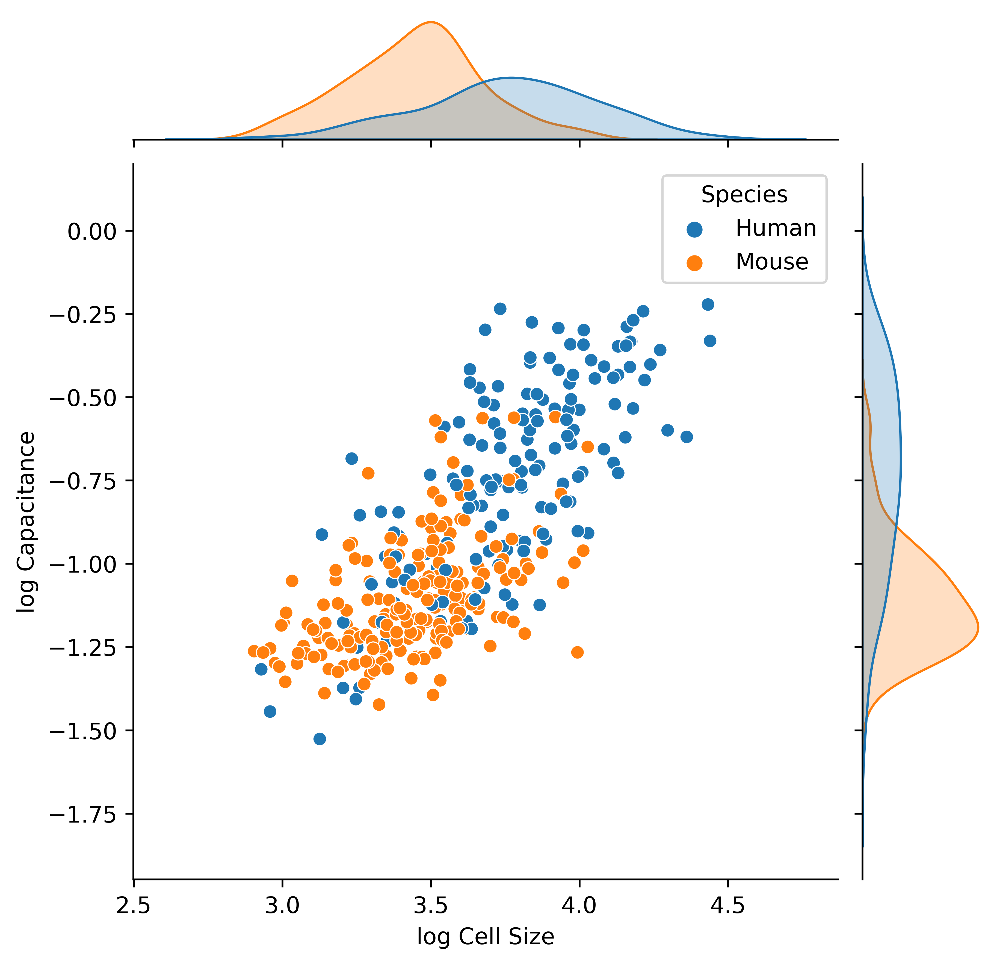

In [249]:
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=np.log10(max_FR_df["capacitance"]),hue=max_FR_df['Species'])
grid.set_axis_labels('log Cell Size', 'log Capacitance')

In [260]:
pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["nm_volume"]), np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["capacitance"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-3.025873,0.263627,-11.477876,1.566679e-14,0.571681,0.561483,-3.557893,-2.493853
1,nm_volume,0.570978,0.076261,7.487174,2.945429e-09,0.571681,0.561483,0.417077,0.724878


In [257]:
pg.corr(max_FR_df[max_FR_df['Species']=='Human']["nm_volume"],max_FR_df[max_FR_df['Species']=='Human']["capacitance"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,156,0.709905,"[0.62, 0.78]",0.503965,0.497481,3.221187e-25,1.0


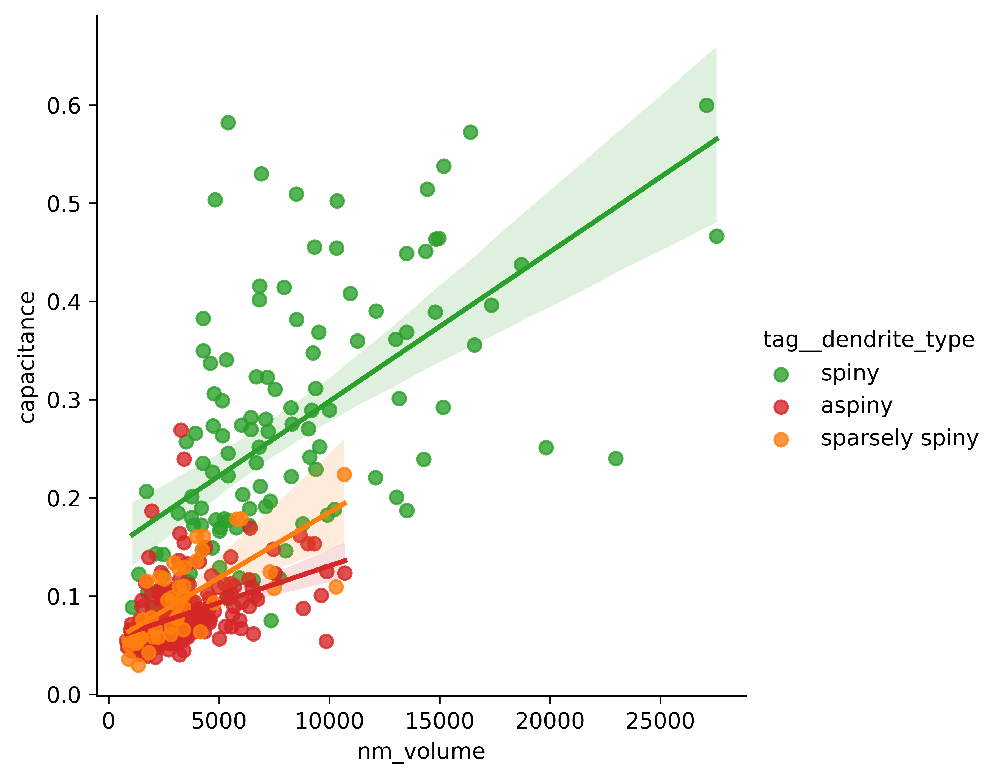

In [199]:
sns.lmplot(data=max_FR_df, x="nm_volume", y="capacitance", hue="tag__dendrite_type",palette=palette)

<AxesSubplot:xlabel='nm_volume', ylabel='capacitance'>

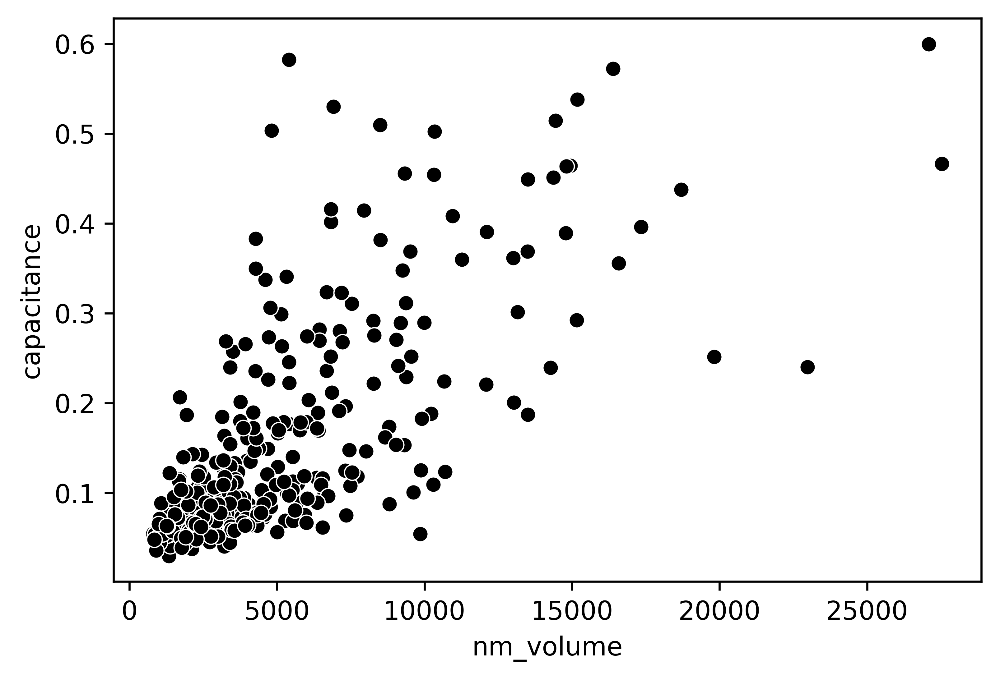

In [197]:
sns.scatterplot(data=max_FR_df, x="nm_volume", y="capacitance",color='black')

<AxesSubplot:xlabel='nm_volume', ylabel='capacitance'>

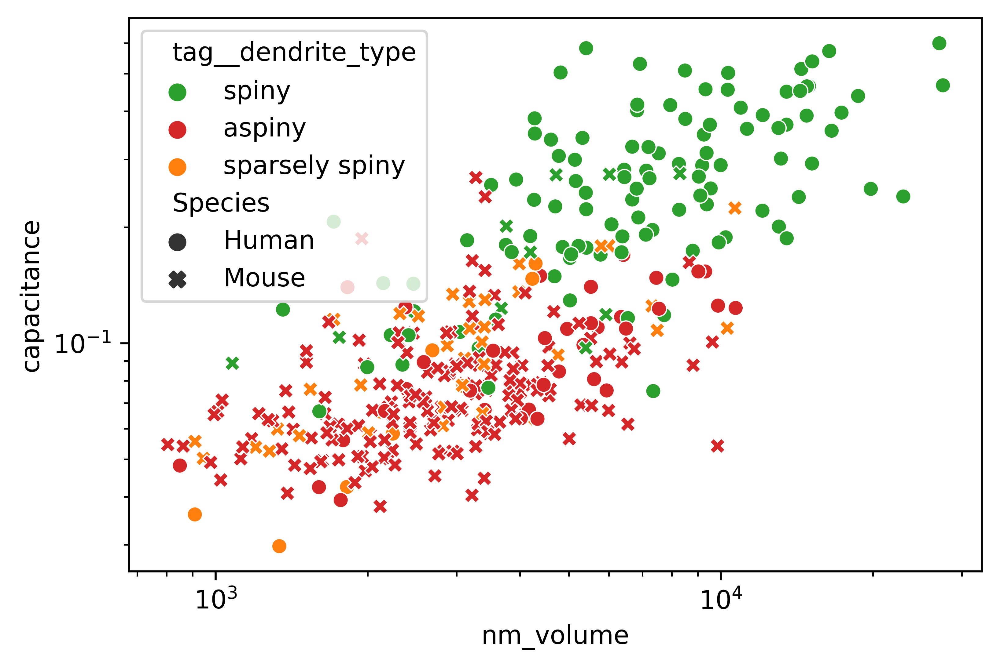

In [262]:
fig, ax = plt.subplots()
ax.set(xscale="log", yscale='log')
sns.scatterplot(data=max_FR_df, x="nm_volume", y="capacitance", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

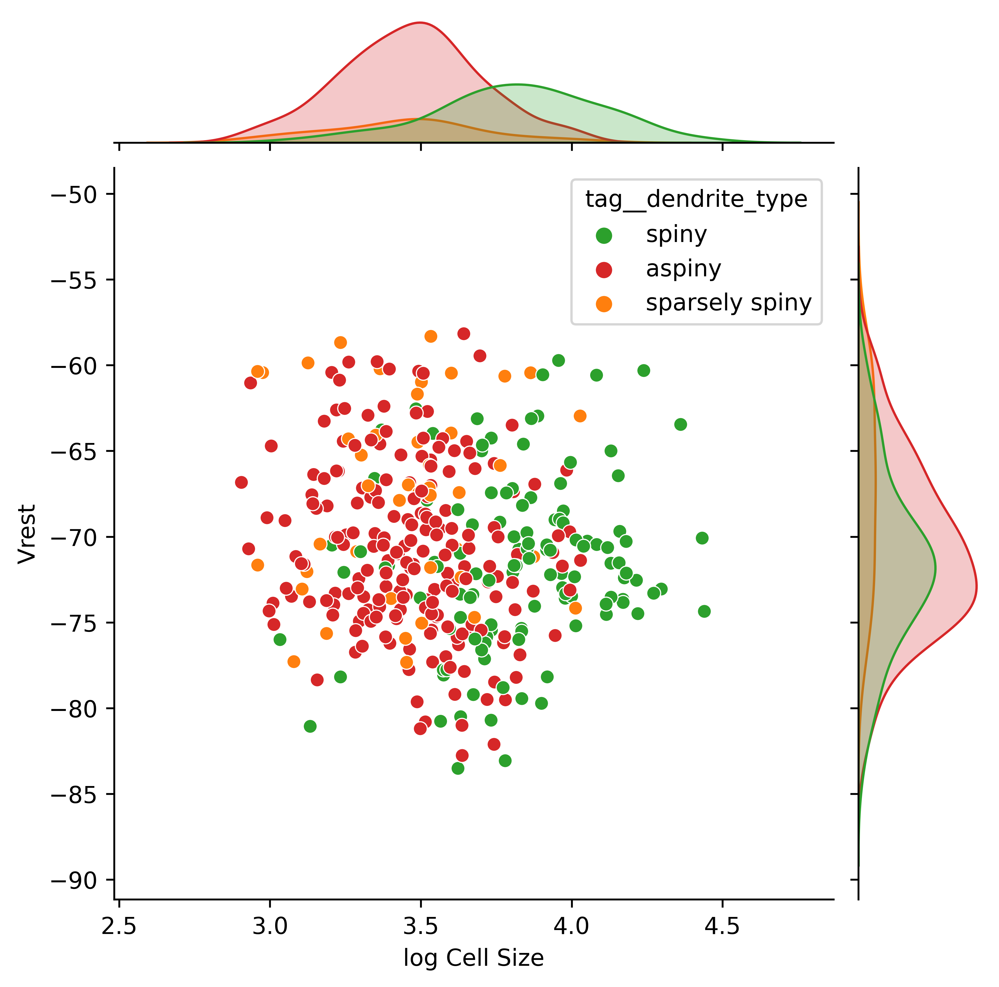

In [278]:
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=max_FR_df["ef__vrest"],hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'Vrest')

In [275]:
pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["nm_volume"]), max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["ef__vrest"])

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-69.838643,11.445401,-6.101896,2.833909e-07,0.001049,-0.022736,-92.936396,-46.740889
1,nm_volume,0.695164,3.310876,0.209964,8.347112e-01,0.001049,-0.022736,-5.986455,7.376782


In [279]:
pg.corr(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["nm_volume"],max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["ef__vrest"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.028471,"[-0.27, 0.32]",0.000811,-0.04793,0.854442,0.053534


<AxesSubplot:xlabel='nm_volume', ylabel='ef__vrest'>

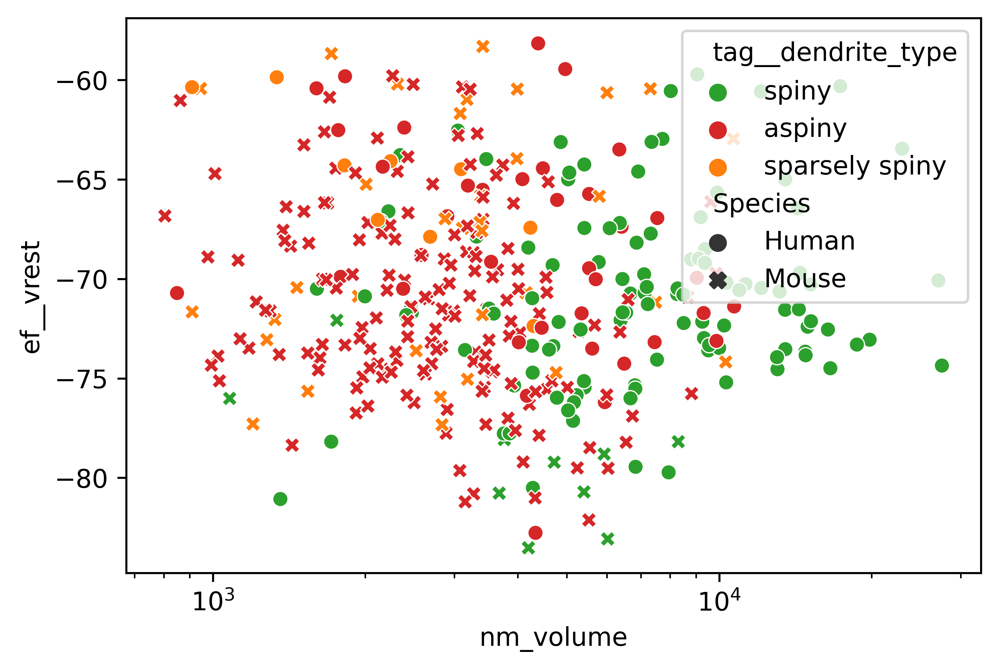

In [282]:
fig, ax = plt.subplots()
ax.set(xscale="log")
sns.scatterplot(data=max_FR_df, x="nm_volume", y="ef__vrest", hue="tag__dendrite_type",palette=palette,style='Species', style_order=['Human','Mouse'])

In [289]:
# do mouse and human have significantly different resting membrane potential? 
pg.mwu(max_FR_df[max_FR_df['Species']=='Human']['ef__vrest'],max_FR_df[max_FR_df['Species']=='Mouse']['ef__vrest'])

,U-val,tail,p-val,RBC,CLES
MWU,18797.0,two-sided,0.019936,-0.142119,0.57106


In [285]:
max_FR_df[max_FR_df['Species']=='Mouse']['ef__vrest'].median()

-71.6596450805664

In [286]:
max_FR_df[max_FR_df['Species']=='Human']['ef__vrest'].median()

-70.59888076782225

In [287]:
max_FR_df[max_FR_df['Species']=='Mouse']['ef__vrest'].mean()

-71.15641896758599

In [288]:
max_FR_df[max_FR_df['Species']=='Human']['ef__vrest'].mean()

-69.98712441860101

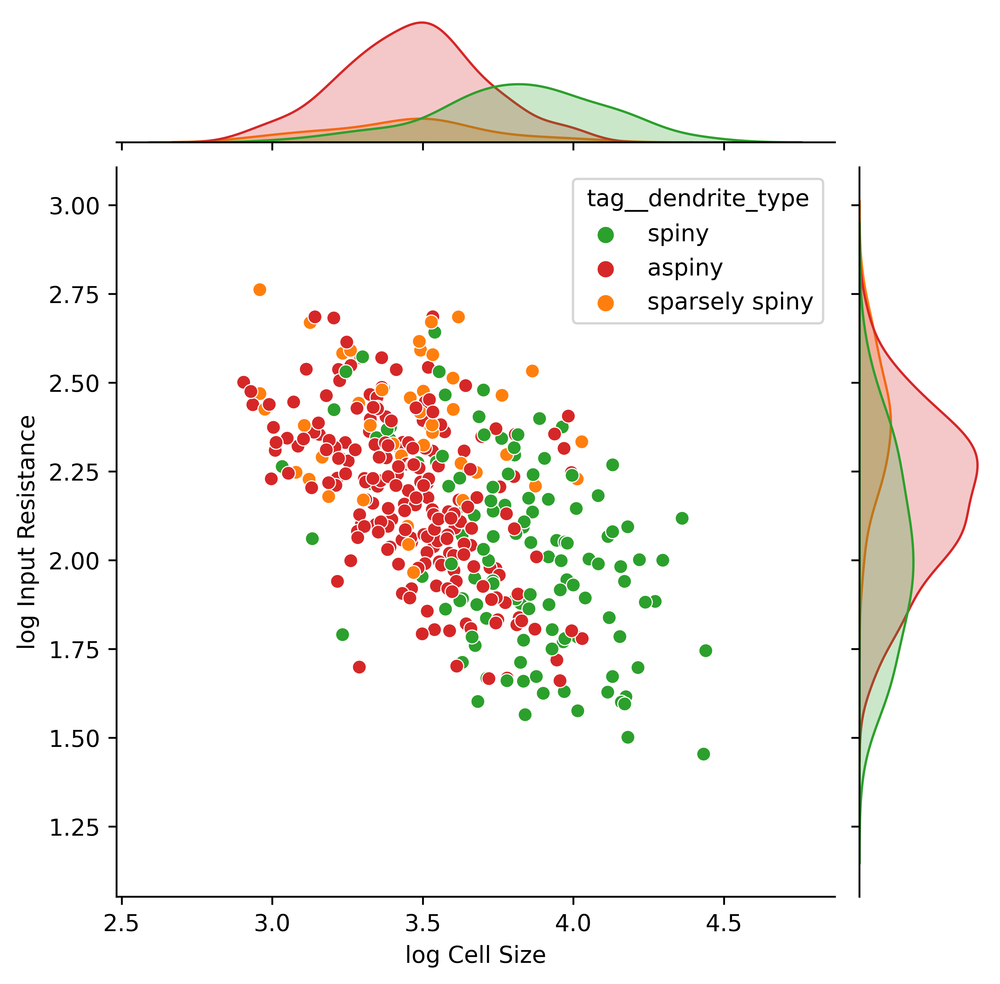

In [294]:
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=np.log10(max_FR_df["ef__ri"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Input Resistance')

In [301]:
pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["nm_volume"]), np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["ef__ri"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,3.955791,0.198659,19.912420,1.935027e-49,0.285319,0.281763,3.564067,4.347515
1,nm_volume,-0.512473,0.057209,-8.957922,2.265748e-16,0.285319,0.281763,-0.625280,-0.399666


In [306]:
pg.corr(max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["nm_volume"],max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["ef__ri"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,-0.539054,"[-0.63, -0.43]",0.29058,0.283485,1.068831e-16,1.0


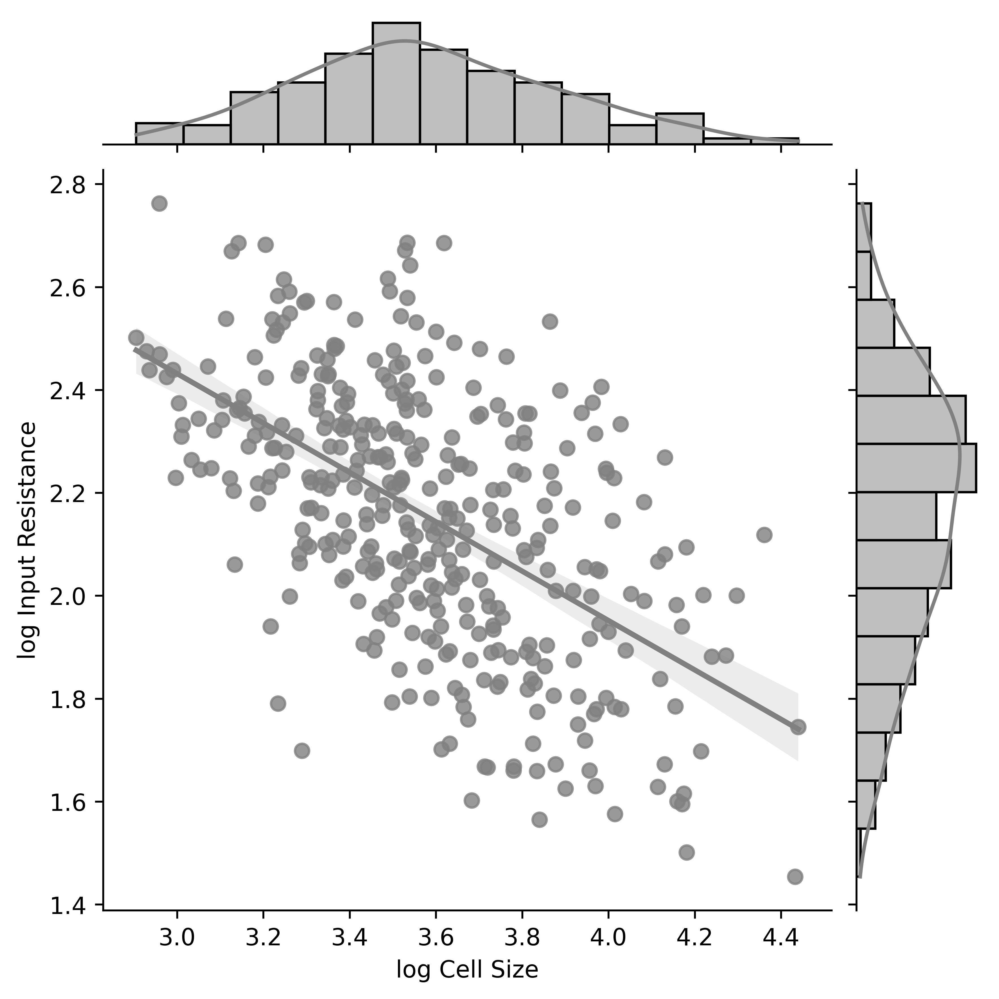

In [296]:
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=np.log10(max_FR_df["ef__ri"]),kind='reg',color='grey')
grid.set_axis_labels('log Cell Size', 'log Input Resistance')

In [298]:
pg.linear_regression(np.log10(max_FR_df["nm_volume"]), np.log10(max_FR_df["ef__ri"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,3.871026,0.133480,29.000846,9.281014e-97,0.313503,0.311622,3.608540,4.133512
1,nm_volume,-0.479836,0.037166,-12.910631,1.138756e-31,0.313503,0.311622,-0.552922,-0.406750


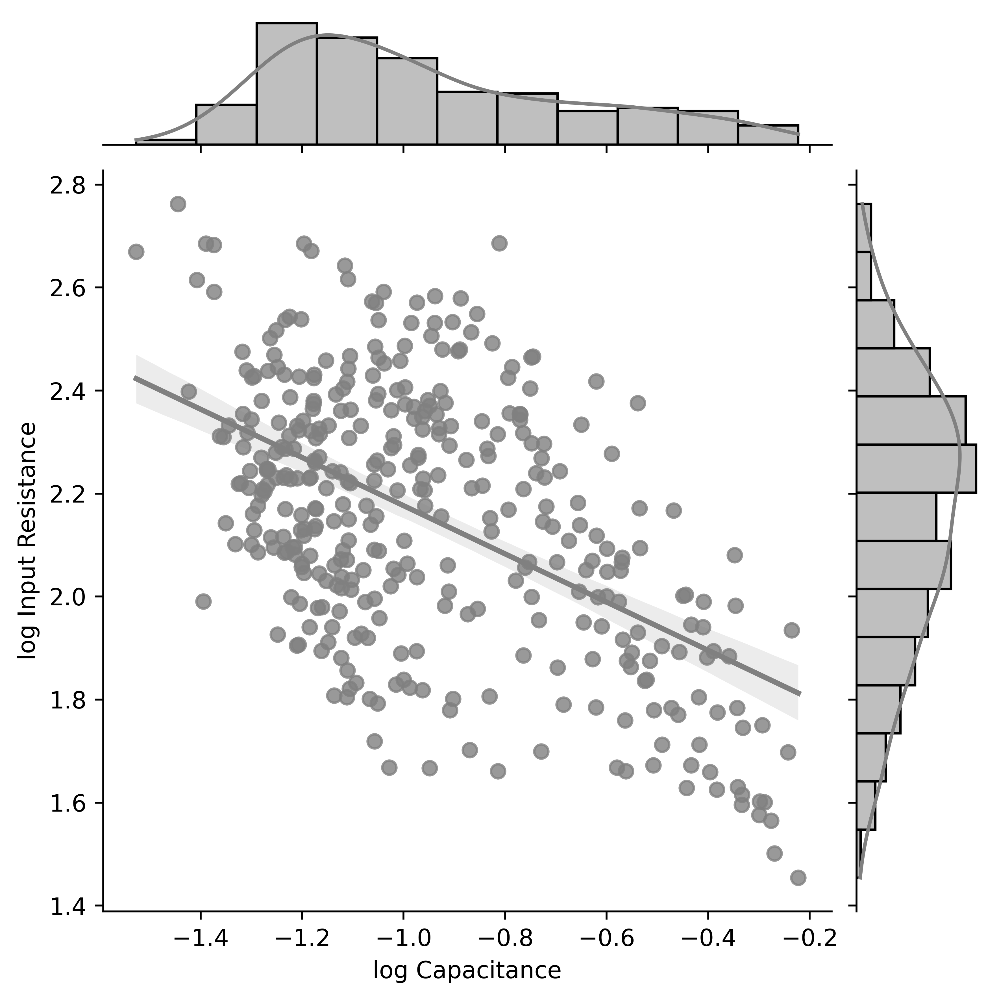

In [307]:
grid = sns.jointplot(x=np.log10(max_FR_df["capacitance"]), y=np.log10(max_FR_df["ef__ri"]),kind='reg',color='grey')
grid.set_axis_labels('log Capacitance', 'log Input Resistance')

In [308]:
pg.linear_regression(np.log10(max_FR_df["capacitance"]), np.log10(max_FR_df["ef__ri"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1.708328,0.038968,43.838939,1.642532e-147,0.281464,0.279495,1.631697,1.784958
1,capacitance,-0.468059,0.039144,-11.957304,4.951121e-28,0.281464,0.279495,-0.545035,-0.391082


In [309]:
pg.corr(max_FR_df["capacitance"],max_FR_df["ef__ri"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,367,-0.424817,"[-0.51, -0.34]",0.18047,0.175967,1.631966e-17,1.0


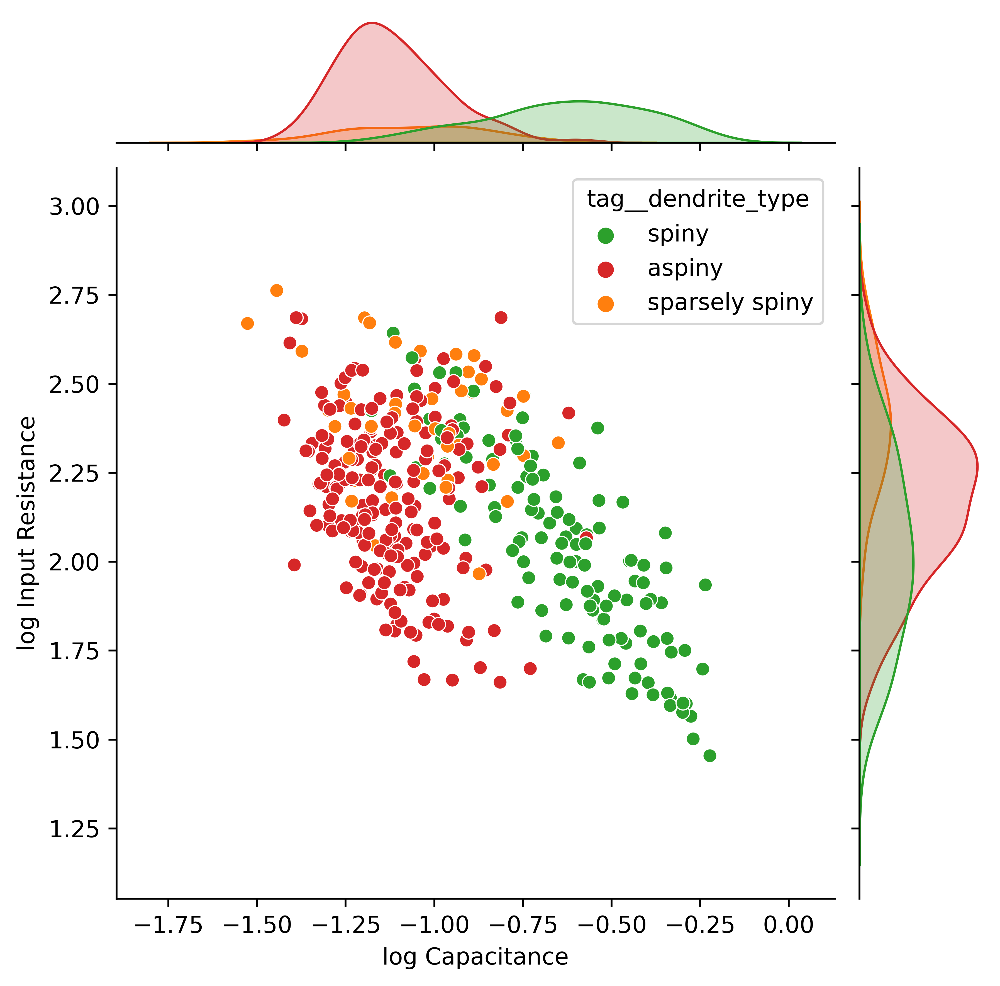

In [310]:
grid = sns.jointplot(x=np.log10(max_FR_df["capacitance"]), y=np.log10(max_FR_df["ef__ri"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Capacitance', 'log Input Resistance')

In [313]:
pg.corr(max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["capacitance"],max_FR_df[max_FR_df['tag__dendrite_type']=='aspiny']["ef__ri"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,-0.192662,"[-0.32, -0.06]",0.037119,0.02749,0.005889,0.789661


In [315]:
pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='spiny']["capacitance"]), np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='spiny']["ef__ri"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1.413134,0.041498,34.052911,7.070978e-63,0.674005,0.671243,1.330957,1.495312
1,capacitance,-0.973580,0.062331,-15.619509,1.692140e-30,0.674005,0.671243,-1.097013,-0.850148


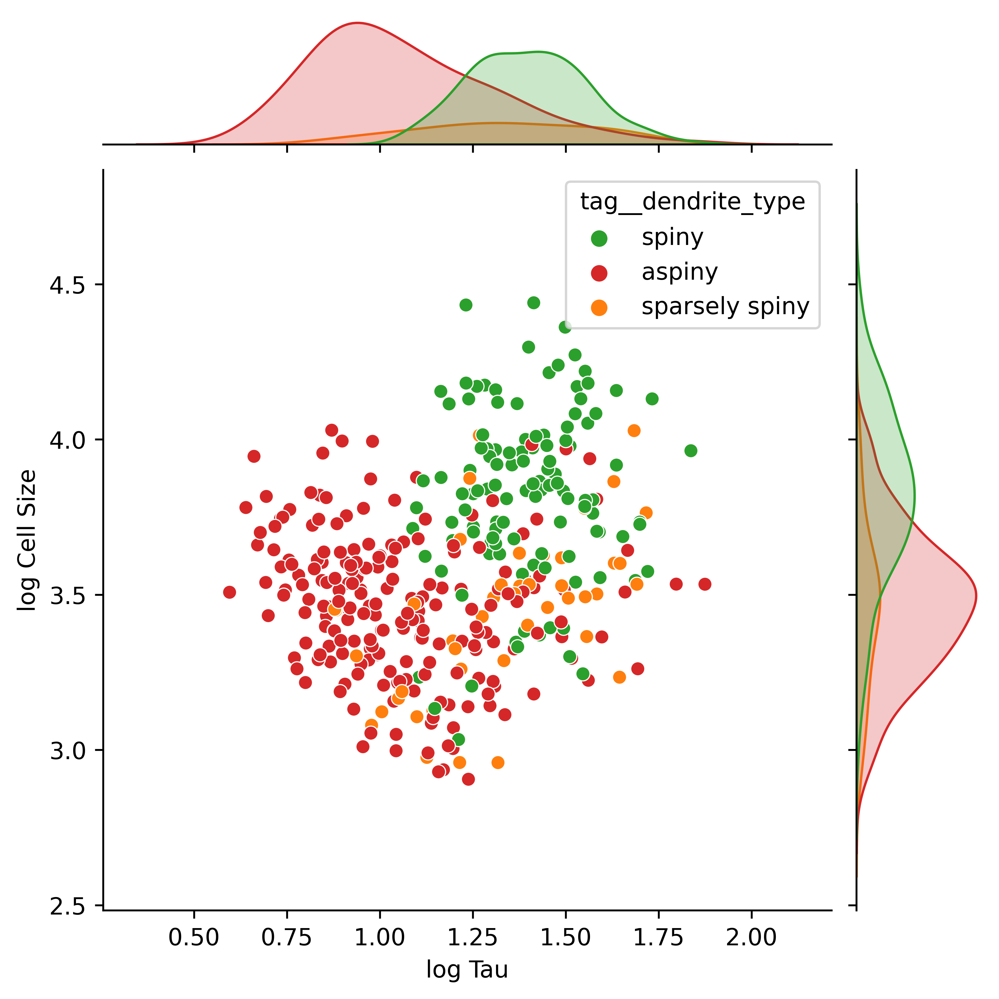

In [316]:
grid = sns.jointplot(x=np.log10(max_FR_df["ef__tau"]), y=np.log10(max_FR_df["nm_volume"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Tau', 'log Cell Size')

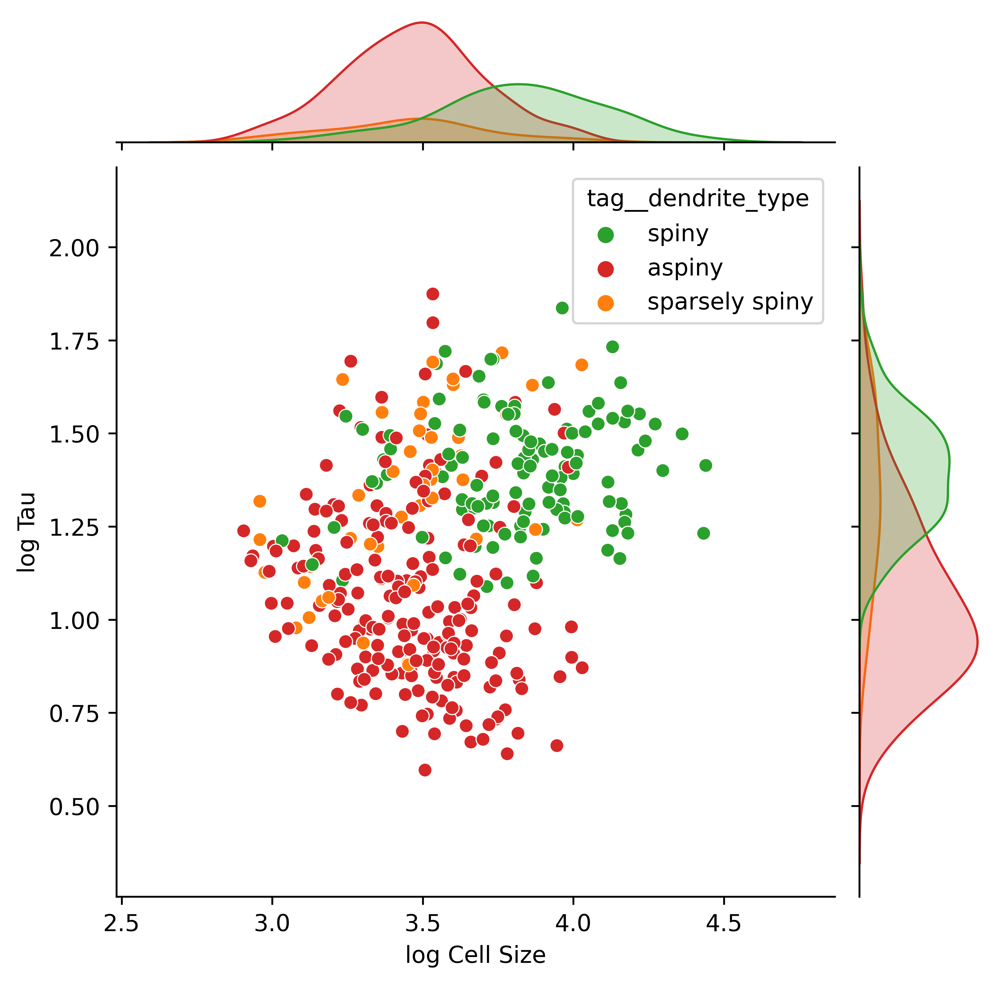

In [317]:
grid = sns.jointplot(x=np.log10(max_FR_df["nm_volume"]), y=np.log10(max_FR_df["ef__tau"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Tau')

In [323]:
pg.corr(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["nm_volume"],max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["ef__tau"],method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.582664,"[0.35, 0.75]",0.339497,0.307278,0.000033,0.990562


In [325]:
pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["nm_volume"]), np.log10(max_FR_df[max_FR_df['tag__dendrite_type']=='sparsely spiny']["ef__tau"]))

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-0.259895,0.407493,-0.637790,0.527072,0.267275,0.249829,-1.082249,0.562459
1,nm_volume,0.461387,0.117878,3.914114,0.000327,0.267275,0.249829,0.223500,0.699274


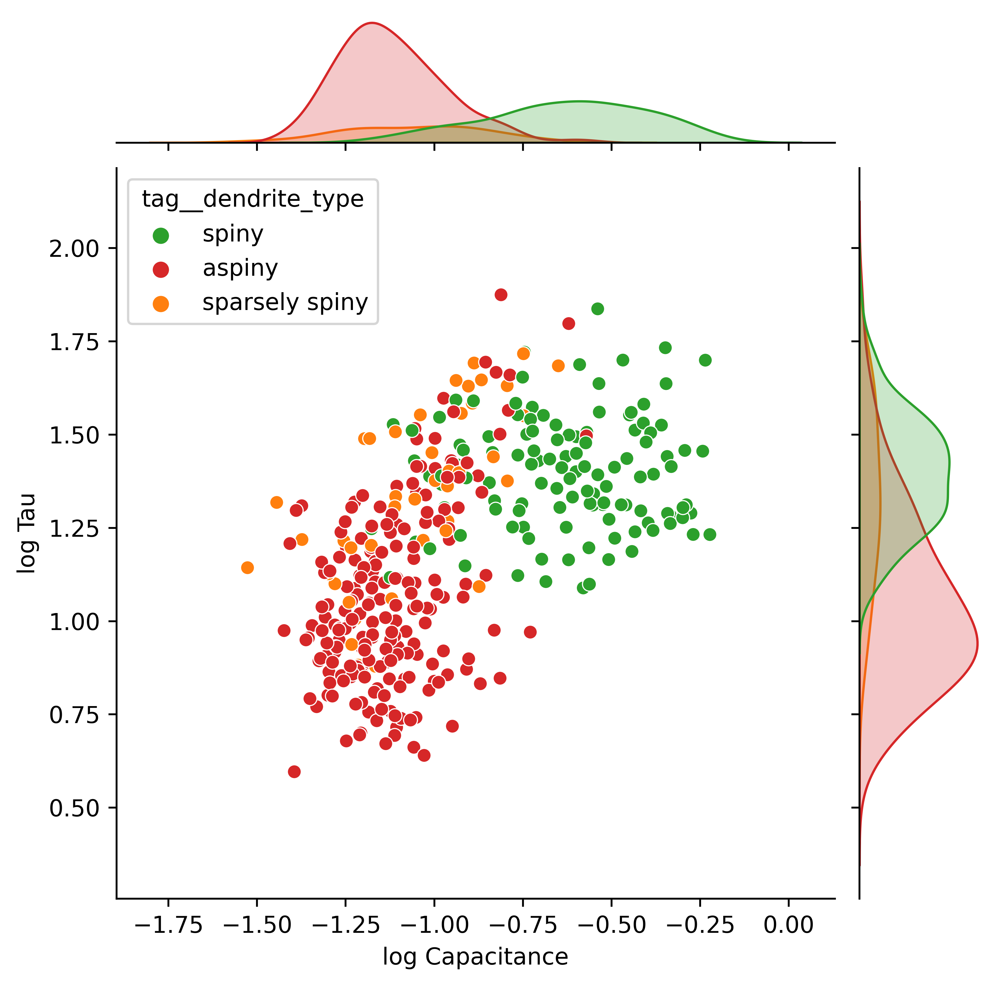

In [319]:
grid = sns.jointplot(x=np.log10(max_FR_df["capacitance"]), y=np.log10(max_FR_df["ef__tau"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Capacitance', 'log Tau')

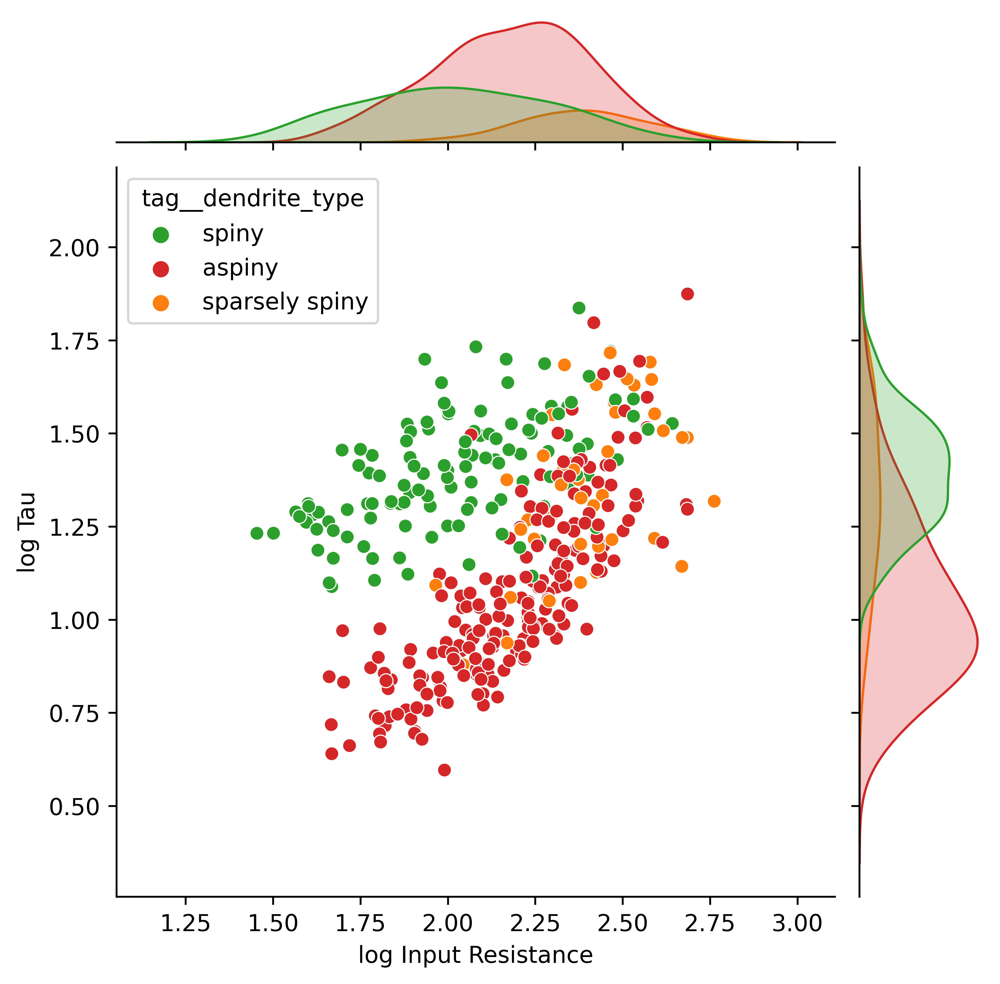

In [320]:
grid = sns.jointplot(x=np.log10(max_FR_df["ef__ri"]), y=np.log10(max_FR_df["ef__tau"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Input Resistance', 'log Tau')

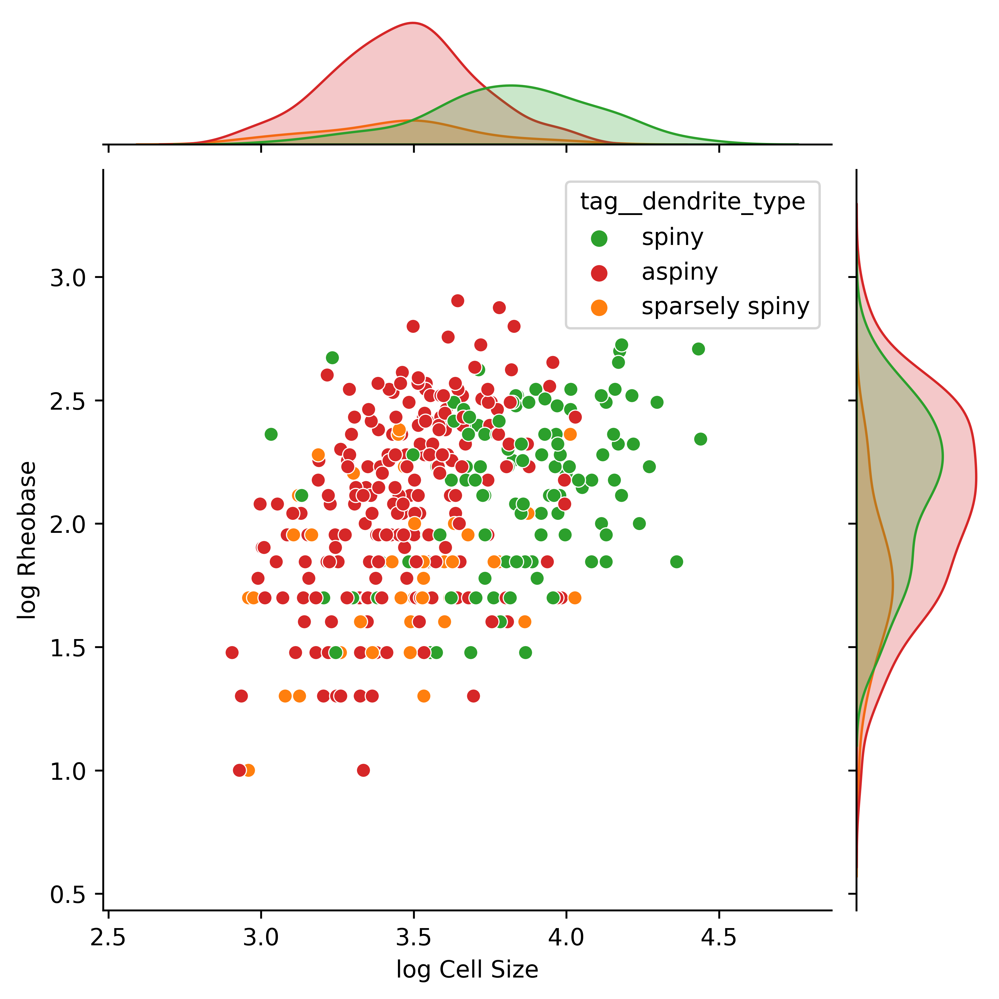

In [329]:
grid = sns.jointplot(x=np.log10(max_FR_df['nm_volume']), y=np.log10(max_FR_df["ef__threshold_i_long_square"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Rheobase')

In [331]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [334]:
x = 'nm_volume'
y = 'ef__threshold_i_long_square'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(max_FR_df[max_FR_df['tag__dendrite_type']==celltype][x],max_FR_df[max_FR_df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(max_FR_df[max_FR_df['tag__dendrite_type']==celltype][x]), np.log10(max_FR_df[max_FR_df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,120,0.387734,"[0.22, 0.53]",0.150337,0.135813,0.000012,0.993467


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,0.284960,0.382250,0.74548,0.457464,0.16425,0.157168,-0.471999,1.041918
1,nm_volume,0.480647,0.099809,4.81566,0.000004,0.16425,0.157168,0.282998,0.678296


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,0.424471,"[0.3, 0.53]",0.180176,0.171977,2.764699e-10,0.999996


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-0.287124,0.367667,-0.780936,4.357588e-01,0.171618,0.167496,-1.012103,0.437855
1,nm_volume,0.683239,0.105879,6.453032,8.034019e-10,0.171618,0.167496,0.474464,0.892015


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.200801,"[-0.1, 0.47]",0.040321,-0.006493,0.191221,0.260109


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,0.685629,0.602344,1.138267,0.261460,0.073672,0.051616,-0.529951,1.901209
1,nm_volume,0.318456,0.174244,1.827646,0.074713,0.073672,0.051616,-0.033182,0.670093


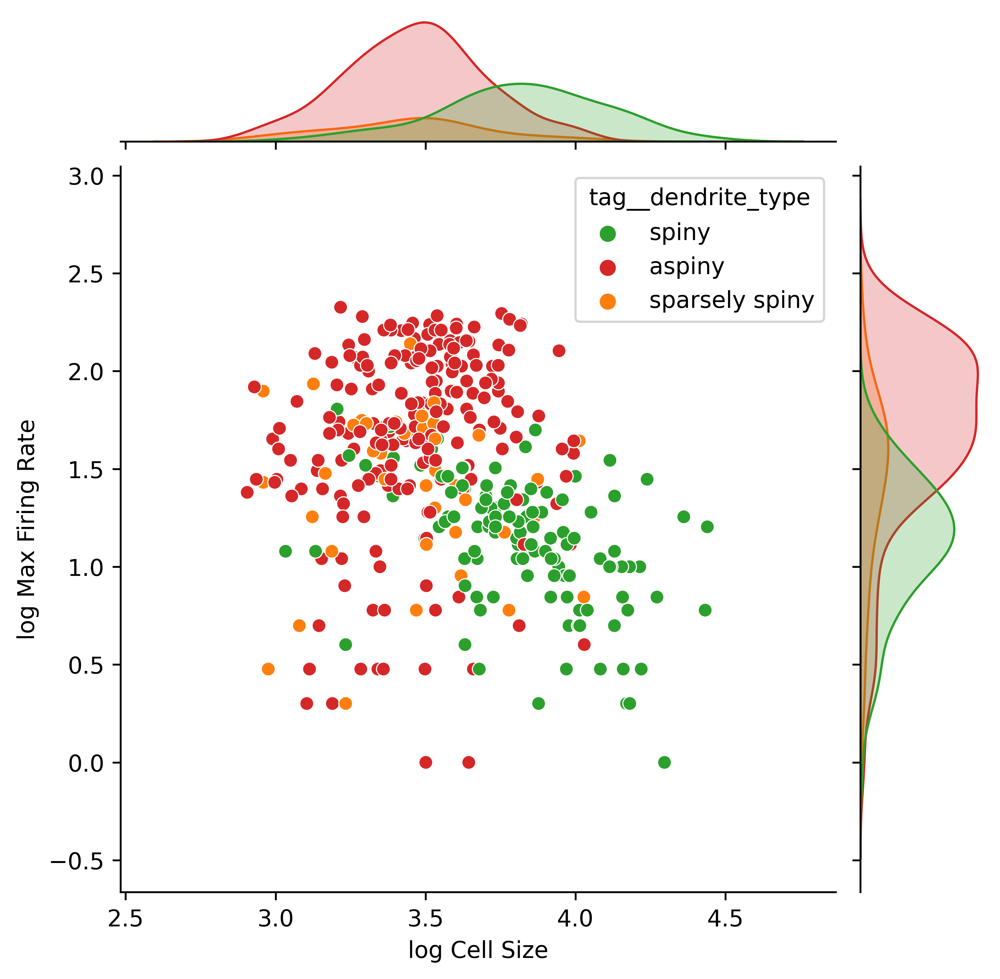

In [335]:
grid = sns.jointplot(x=np.log10(max_FR_df['nm_volume']), y=np.log10(max_FR_df["sweep_FR"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Max Firing Rate')

In [344]:
df = max_FR_df
x = 'nm_volume'
y = 'sweep_FR'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(df[df['tag__dendrite_type']==celltype][x],df[df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(df[df['tag__dendrite_type']==celltype][x]), np.log10(df[df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,120,-0.523061,"[-0.64, -0.38]",0.273593,0.261176,8.851415e-10,0.999993


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,3.468389,0.387885,8.941805,6.313237e-15,0.2393,0.232854,2.700272,4.236506
1,nm_volume,-0.617066,0.101281,-6.092646,1.433350e-08,0.2393,0.232854,-0.817629,-0.416503


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,0.223843,"[0.09, 0.35]",0.050106,0.040607,0.001325,0.897482


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,0.604537,0.501483,1.205499,0.229428,0.022195,0.01733,-0.384305,1.593379
1,nm_volume,0.308468,0.144414,2.135994,0.033889,0.022195,0.01733,0.023707,0.593230


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,-0.102421,"[-0.39, 0.2]",0.01049,-0.037779,0.508246,0.101554


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1.031083,0.918600,1.122451,0.268047,0.004002,-0.019712,-0.822727,2.884894
1,nm_volume,0.109159,0.265729,0.410792,0.683313,0.004002,-0.019712,-0.427103,0.645422


In [336]:
len(stimulus_150_df)

300

In [338]:
len(stimulus_50_df)

324

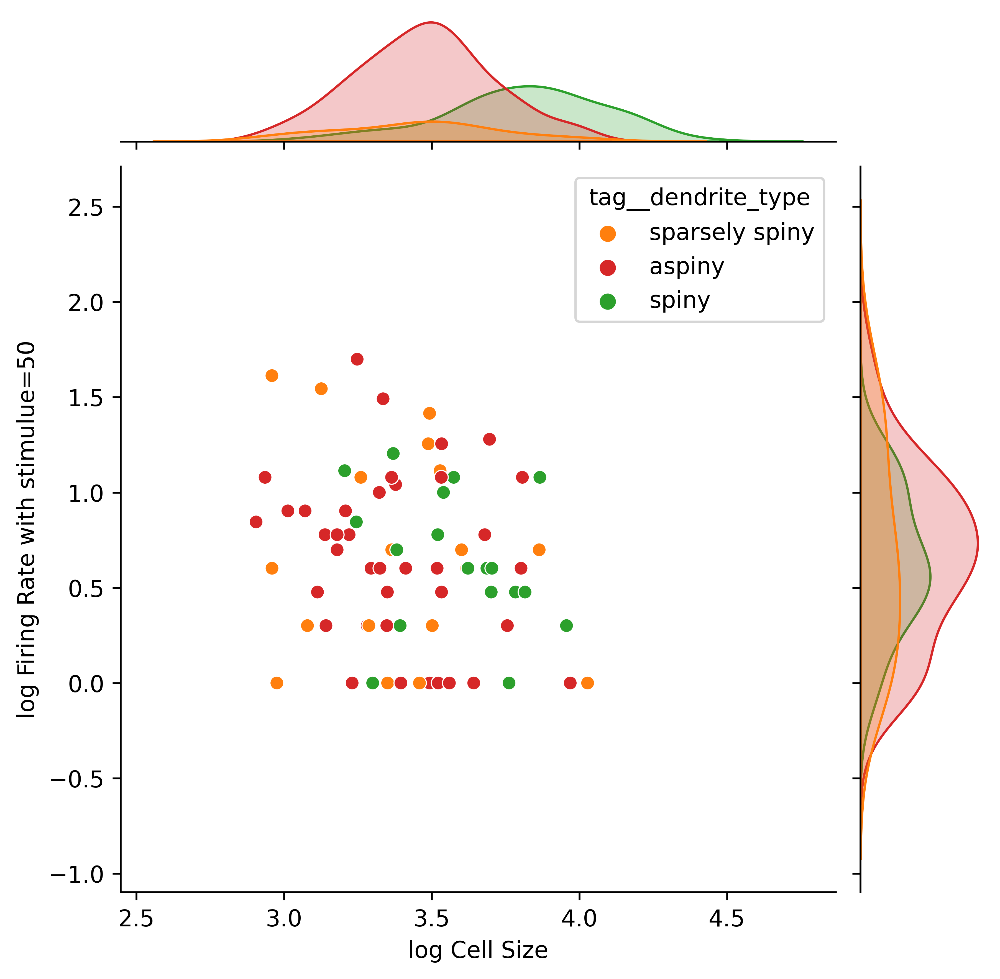

In [341]:
grid = sns.jointplot(x=np.log10(stimulus_50_df['nm_volume']), y=np.log10(stimulus_50_df["sweep_FR"]),hue=stimulus_50_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Firing Rate with stimulue=50')

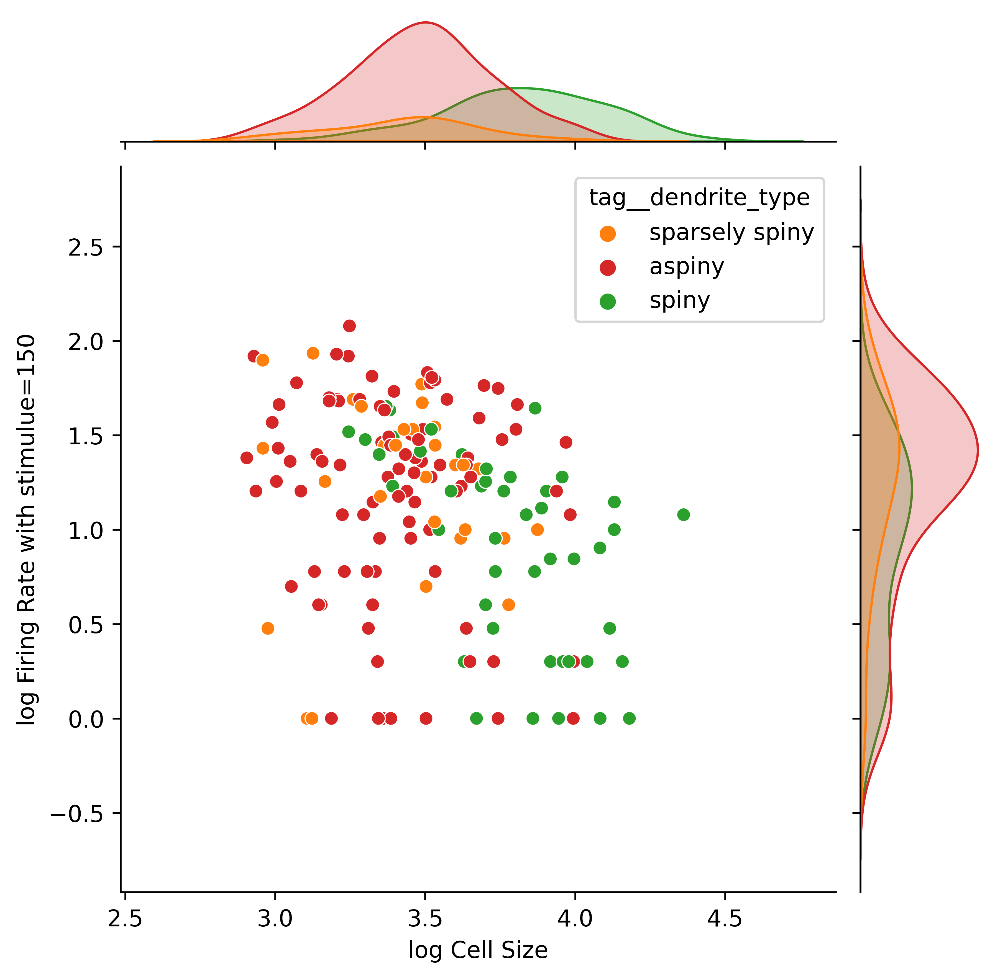

In [342]:
grid = sns.jointplot(x=np.log10(stimulus_150_df['nm_volume']), y=np.log10(stimulus_150_df["sweep_FR"]),hue=stimulus_150_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Firing Rate with stimulue=150')

In [346]:
df = stimulus_150_df.dropna(subset=['sweep_FR'])
x = 'nm_volume'
y = 'sweep_FR'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(df[df['tag__dendrite_type']==celltype][x],df[df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(df[df['tag__dendrite_type']==celltype][x]), np.log10(df[df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,47,-0.597614,"[-0.76, -0.37]",0.357142,0.327921,0.000009,0.996016


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,5.022321,0.912719,5.502596,0.000002,0.312872,0.297602,3.184012,6.860631
1,nm_volume,-1.088912,0.240559,-4.526585,0.000044,0.312872,0.297602,-1.573423,-0.604400


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,95,-0.063316,"[-0.26, 0.14]",0.004009,-0.017643,0.542148,0.093544


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,2.099564,0.778023,2.698588,0.008270,0.01488,0.004287,0.554564,3.644563
1,nm_volume,-0.270076,0.227874,-1.185202,0.238957,0.01488,0.004287,-0.722588,0.182436


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,30,-0.234639,"[-0.55, 0.14]",0.055056,-0.01494,0.212003,0.242281


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1.263591,1.289445,0.979950,0.335503,0.00002,-0.035693,-1.377716,3.904899
1,nm_volume,-0.008961,0.375900,-0.023839,0.981150,0.00002,-0.035693,-0.778958,0.761036


(-5.0, 3.0)

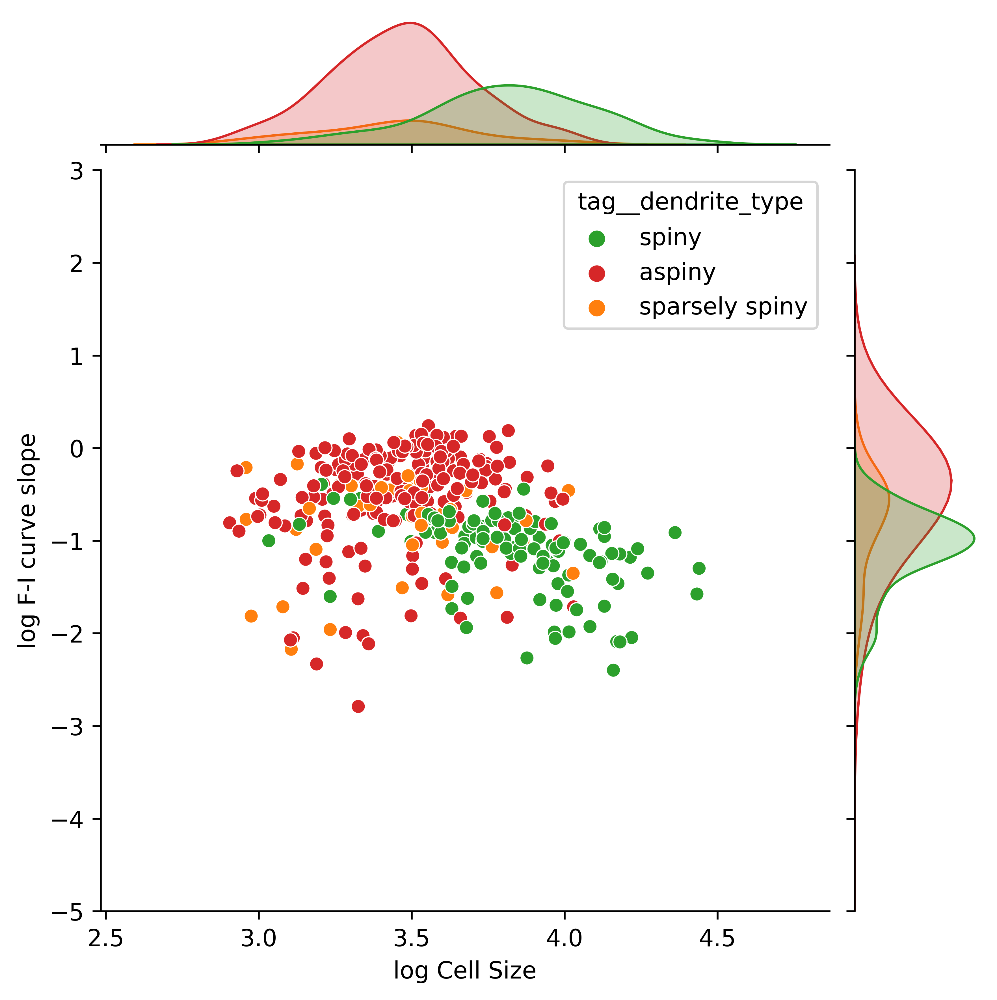

In [360]:
df=max_FR_df[max_FR_df['ef__f_i_curve_slope'] > 0]
grid = sns.jointplot(x=np.log10(df['nm_volume']), y=np.log10(df["ef__f_i_curve_slope"]),hue=df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log F-I curve slope')
grid.ax_marg_y.set_ylim(-5, 3)

In [361]:
df = stimulus_150_df.dropna(subset=['sweep_FR'])
x = 'nm_volume'
y = 'ef__f_i_curve_slope'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(df[df['tag__dendrite_type']==celltype][x],df[df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(df[df['tag__dendrite_type']==celltype][x]), np.log10(df[df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,47,-0.642461,"[-0.78, -0.44]",0.412756,0.386063,0.000001,0.999156


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,1.842685,0.584104,3.154722,0.002862,0.336639,0.321898,0.666240,3.019130
1,nm_volume,-0.735680,0.153948,-4.778746,0.000019,0.336639,0.321898,-1.045748,-0.425612


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,95,0.194569,"[-0.01, 0.38]",0.037857,0.016941,0.058836,0.475683


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-0.863813,2.612319,-0.330669,0.741638,0.000004,-0.010749,-6.051361,4.323734
1,nm_volume,0.013994,0.765117,0.018290,0.985446,0.000004,-0.010749,-1.505377,1.533365


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,30,-0.264071,"[-0.57, 0.11]",0.069734,0.000825,0.158512,0.296581


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-0.760541,1.247054,-0.609870,0.546866,8.970788e-07,-0.035713,-3.315016,1.793935
1,nm_volume,0.001822,0.363543,0.005012,0.996037,8.970788e-07,-0.035713,-0.742861,0.746505


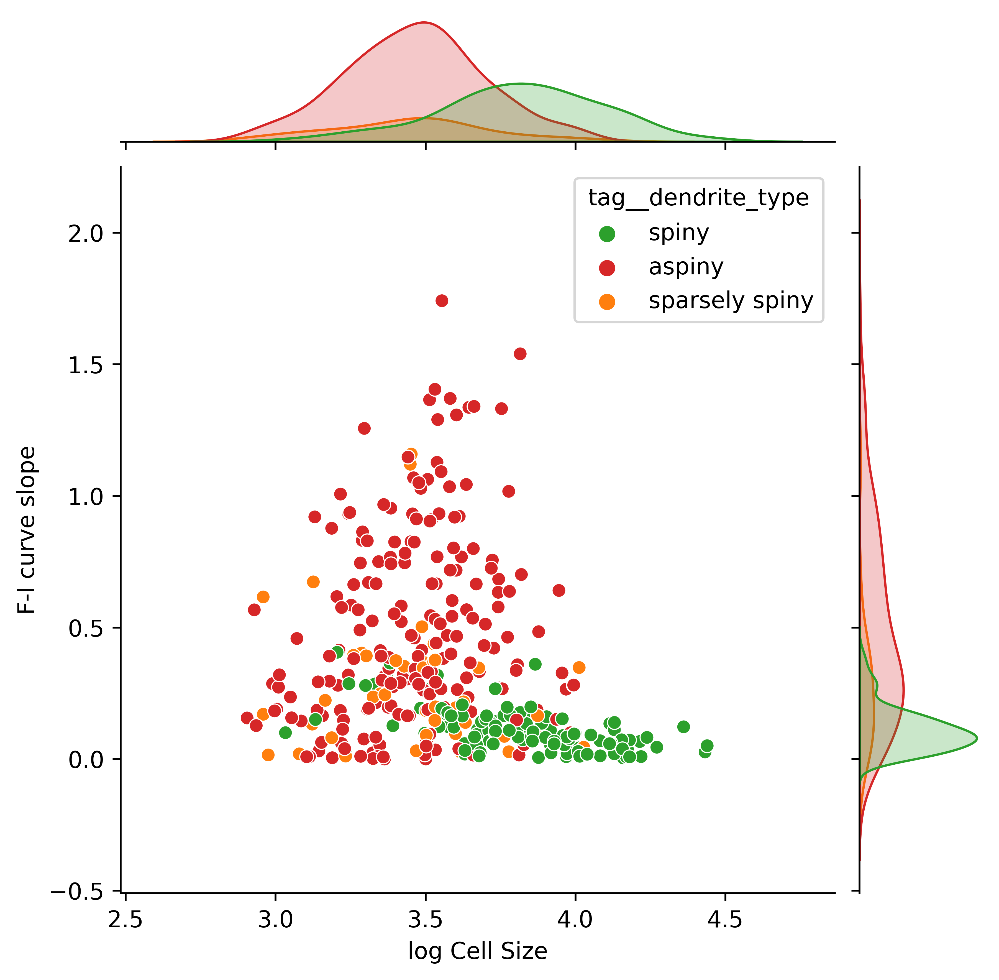

In [357]:
df=max_FR_df[max_FR_df['ef__f_i_curve_slope'] > 0]
grid = sns.jointplot(x=np.log10(df['nm_volume']), y=df["ef__f_i_curve_slope"],hue=df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'F-I curve slope')

In [351]:
len(max_FR_df)

367

In [352]:
len(max_FR_df.dropna(subset=['sweep_FR']))

367

In [364]:
max_FR_df['FRxC']=max_FR_df['sweep_FR']*max_FR_df['capacitance']

<ipython-input-364-5e7f40e9d618>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  max_FR_df['FRxC']=max_FR_df['sweep_FR']*max_FR_df['capacitance']


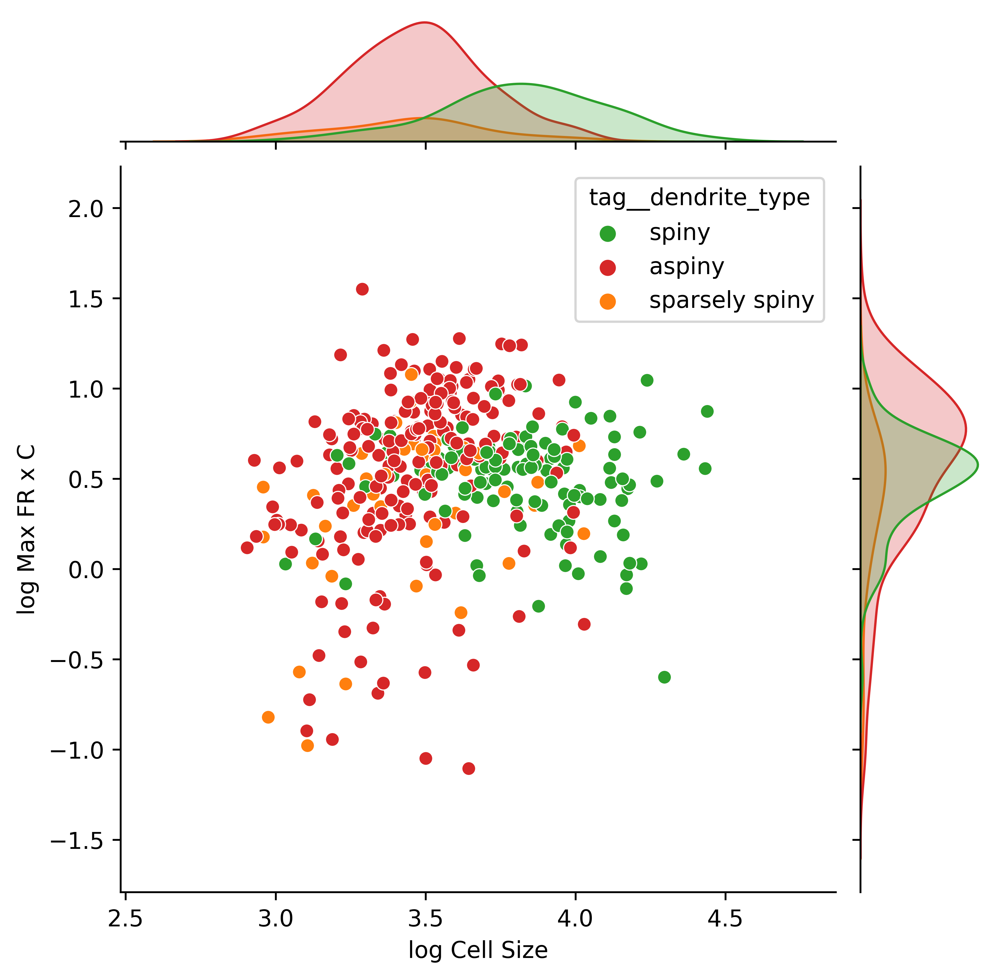

In [366]:
grid = sns.jointplot(x=np.log10(max_FR_df['nm_volume']), y=np.log10(max_FR_df["FRxC"]),hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'log Max FR x C')

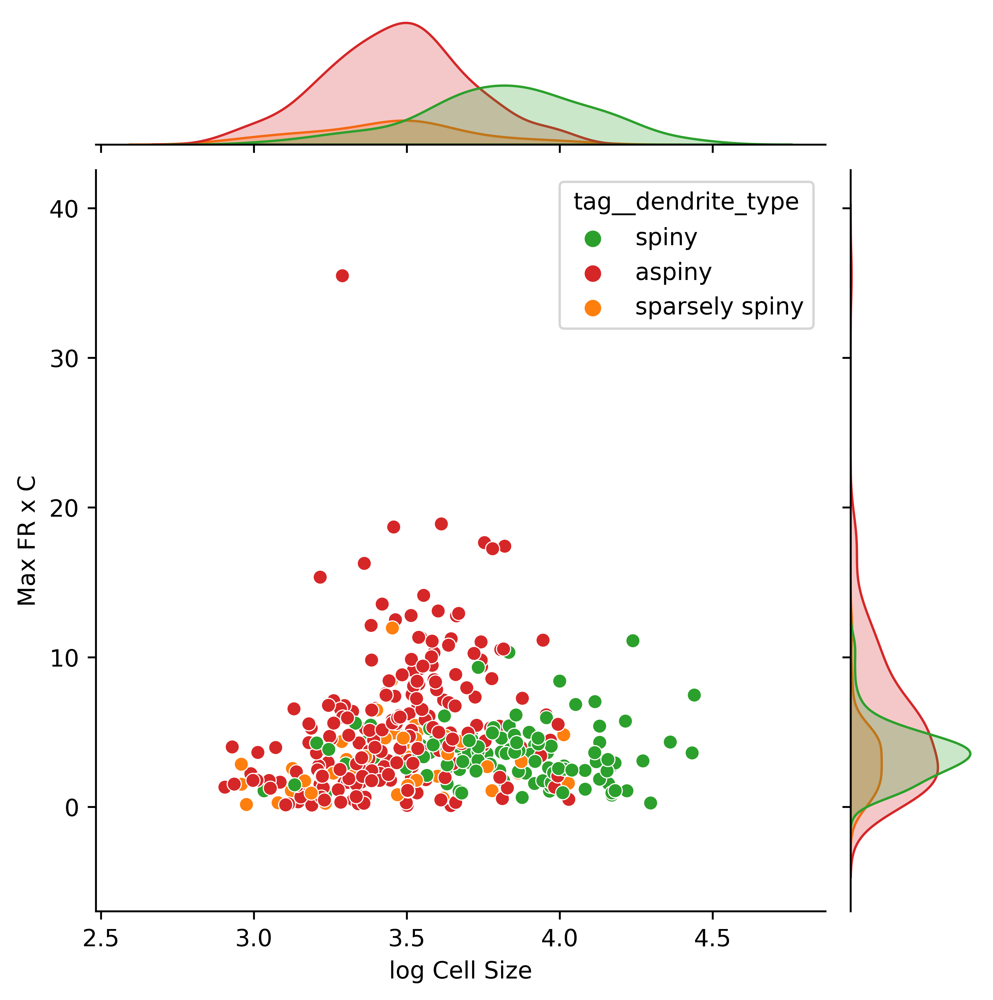

In [368]:
grid = sns.jointplot(x=np.log10(max_FR_df['nm_volume']), y=max_FR_df["FRxC"],hue=max_FR_df['tag__dendrite_type'],palette=palette)
grid.set_axis_labels('log Cell Size', 'Max FR x C')

In [369]:
df = max_FR_df
x = 'nm_volume'
y = 'FRxC'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(df[df['tag__dendrite_type']==celltype][x],df[df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(df[df['tag__dendrite_type']==celltype][x]), np.log10(df[df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,120,-0.117661,"[-0.29, 0.06]",0.013844,-0.003013,0.200591,0.249748


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,0.766520,0.335385,2.285493,0.024069,0.005982,-0.002442,0.102366,1.430674
1,nm_volume,-0.073794,0.087572,-0.842660,0.401124,0.005982,-0.002442,-0.247211,0.099623


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,0.40859,"[0.29, 0.52]",0.166946,0.158615,1.432446e-09,0.999986


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-1.667215,0.484887,-3.438356,0.000711,0.094792,0.090288,-2.623333,-0.711097
1,nm_volume,0.640625,0.139635,4.587847,0.000008,0.094792,0.090288,0.365287,0.915963


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.305849,"[0.01, 0.55]",0.093544,0.049326,0.043483,0.533059


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-1.994789,0.837679,-2.381330,0.021859,0.157945,0.137896,-3.685293,-0.304286
1,nm_volume,0.680137,0.242320,2.806771,0.007555,0.157945,0.137896,0.191115,1.169158


AttributeError: 'JointGrid' object has no attribute 'map'

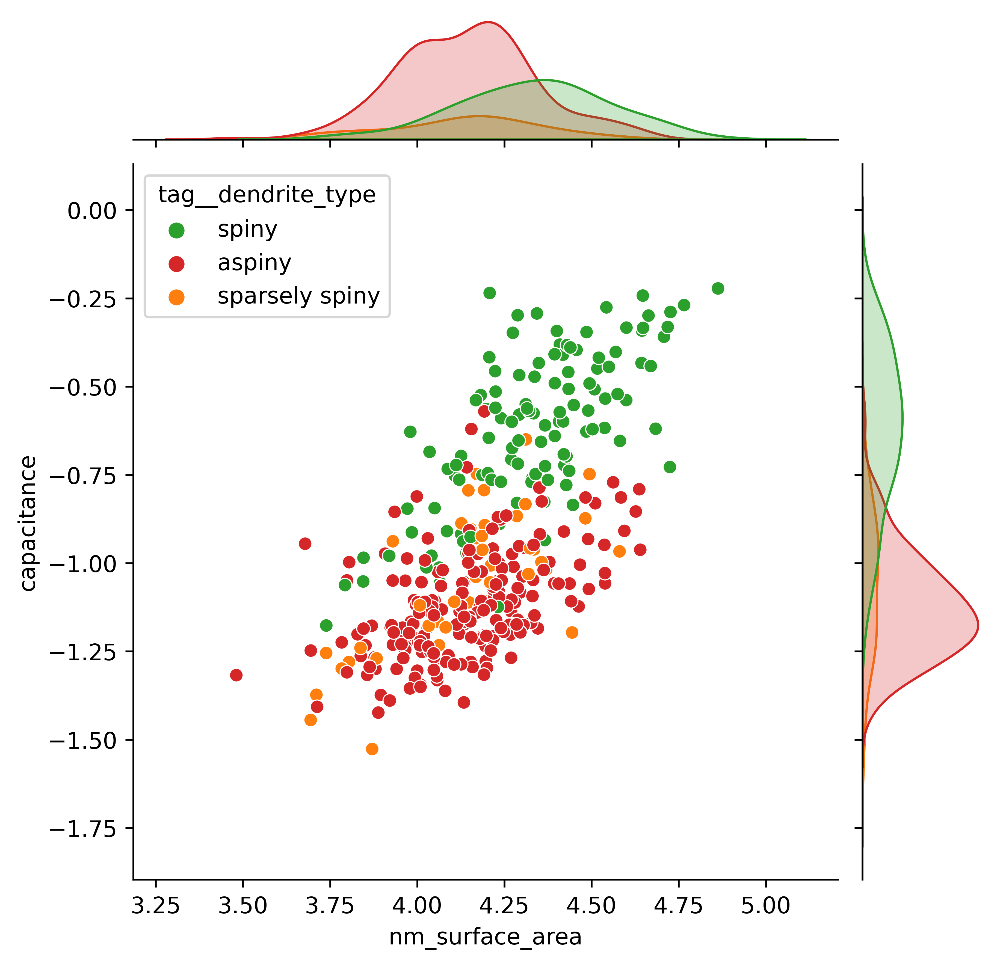

In [374]:
df = max_FR_df
x = 'nm_surface_area'
y = 'capacitance'
hue = 'tag__dendrite_type'
grid = sns.jointplot(x=np.log10(df[x]), y=np.log10(df[y]),hue=df[hue],palette=palette)
# grid.map(sns.regplot, "x", "y", ci=None, robust=1)
for _,gr in df.groupby(hue):
    sns.regplot(x=x_col, y=y_col, data=gr, scatter=False, ax=g.ax_joint, truncate=False)
grid.set_axis_labels('log Cell Surface Area', 'capacitance')

In [ ]:
g = sns.FacetGrid(df, hue='df', palette=pal, size=5);
g.map(plt.scatter, "x", "y", s=50, alpha=.7, linewidth=.5, edgecolor="white")
g.map(sns.regplot, "x", "y", ci=None, robust=1)
g.add_legend();

In [373]:
df = max_FR_df
x = 'nm_surface_area'
y = 'capacitance'
for celltype in ['spiny','aspiny','sparsely spiny']:
    print(celltype)
    pg.corr(df[df['tag__dendrite_type']==celltype][x],df[df['tag__dendrite_type']==celltype][y],method='spearman')
    pg.linear_regression(np.log10(df[df['tag__dendrite_type']==celltype][x]), np.log10(df[df['tag__dendrite_type']==celltype][y]))

spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,120,0.664331,"[0.55, 0.75]",0.441335,0.431786,1.318682e-16,1.0


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-3.783597,0.291213,-12.992544,1.663408e-24,0.499612,0.495371,-4.360278,-3.206916
1,nm_surface_area,0.728290,0.067097,10.854353,1.867752e-19,0.499612,0.495371,0.595420,0.861159


aspiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,203,0.512949,"[0.4, 0.61]",0.263117,0.255748,5.098942e-15,1.0


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-2.716880,0.194361,-13.978512,1.820278e-31,0.251625,0.247902,-3.100129,-2.333632
1,nm_surface_area,0.385261,0.046864,8.220819,2.467599e-14,0.251625,0.247902,0.292853,0.477670


sparsely spiny


,n,r,CI95%,r2,adj_r2,p-val,power
spearman,44,0.656519,"[0.45, 0.8]",0.431017,0.403261,0.000001,0.999105


,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,-3.694744,0.420199,-8.792834,4.512894e-11,0.484616,0.472345,-4.542741,-2.846747
1,nm_surface_area,0.638005,0.101523,6.284318,1.548197e-07,0.484616,0.472345,0.433123,0.842888
